## Night Lights (separate csv files)

This notebook works with separate files

Please do not transfrom again the h5 files in csv since I already have that files:
- folder h5 files (VNP46A4_2-20260213_103212)
- folder csv files for each h5 file (csv_image)


Radiance measures:
- amount of light energy emitted from a surface in a specific direction per unit area

If the values are high they represent:
- brighter city lights
- industrial activity
- gas flaring
- ports
- infrastructure

If the values are low they represent:
- rural areas
- dark regions
- oceans
- forests

Area Type $\rightarrow$ Approximate Values (nW/cm²/sr)

- we can assume ( we can also check exactly after we decide some specific areas):

Ocean, forests or not developed rural area $\rightarrow$ 0-0.5

Small towns	$\rightarrow$ 1-5

Cities $\rightarrow$ 10-50

Major urban areas $\rightarrow$ 50-300

Major industries $\rightarrow$ 500

### Import libraries

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import h5py
import numpy as np
import pandas as pd
import os
import glob
import math
import h5py
from matplotlib.colors import Normalize
from matplotlib.colors import LogNorm

### Download separate csv files for each area and each year
!!!!! do not run this again (i already have all the files)

In [ ]:
#folder_path = "VNP46A4_2-20260213_103212"
#output_folder = "csv_images"

#os.makedirs(output_folder, exist_ok=True)

#for filename in os.listdir(folder_path):
    if filename.endswith(".h5"):
        file_path = os.path.join(folder_path, filename)

        with h5py.File(file_path, "r") as f:
            data = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"][:]
            data[data < 0] = np.nan
            data[data <= 0] = np.nan

            if np.isnan(data).all():
                continue

            out_path = os.path.join(output_folder, filename.replace(".h5", ".csv"))
            pd.DataFrame(data).to_csv(out_path, index=False, header=False)

print("Saved individual image CSV files")

### Mock
- work with one csv file
- position of a bird
- distance from the closest city with intes nightlights

#### Transform csv file in df

In [12]:
import pandas as pd
import os

folder_path = "csv_images"

file_name = "VNP46A4.A2021001.h18v04.002.2025149104200.csv"

file_path = os.path.join(folder_path, file_name)

df_1 = pd.read_csv(file_path)

df_1

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 2390,Unnamed: 2391,Unnamed: 2392,Unnamed: 2393,Unnamed: 2394,Unnamed: 2395,Unnamed: 2396,Unnamed: 2397,Unnamed: 2398,Unnamed: 2399
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0.628464,0.649459,0.657258,0.573265,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.070640,2.971441,2.866619,2.024421,1.252761,0.812601,0.588530,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.171257,3.880624,3.822892,2.946836,2.624199,2.439661,1.907079,0.750355,0.505572,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2394,3.933087,4.130098,5.245794,6.840399,7.718996,8.634207,10.531347,18.610660,35.477856,40.899048,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2395,7.035293,7.491023,7.833325,9.534697,11.963099,15.667174,17.409817,25.459696,36.996098,32.241287,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2396,8.660399,8.384824,7.775903,8.102761,10.984263,15.549107,18.720700,21.873003,19.626812,11.066549,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2397,7.217624,7.799217,8.527053,8.575269,8.949645,11.873877,19.262558,21.288973,12.738888,3.976334,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
df_1

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 2390,Unnamed: 2391,Unnamed: 2392,Unnamed: 2393,Unnamed: 2394,Unnamed: 2395,Unnamed: 2396,Unnamed: 2397,Unnamed: 2398,Unnamed: 2399
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0.628464,0.649459,0.657258,0.573265,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.070640,2.971441,2.866619,2.024421,1.252761,0.812601,0.588530,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.171257,3.880624,3.822892,2.946836,2.624199,2.439661,1.907079,0.750355,0.505572,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2394,3.933087,4.130098,5.245794,6.840399,7.718996,8.634207,10.531347,18.610660,35.477856,40.899048,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2395,7.035293,7.491023,7.833325,9.534697,11.963099,15.667174,17.409817,25.459696,36.996098,32.241287,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2396,8.660399,8.384824,7.775903,8.102761,10.984263,15.549107,18.720700,21.873003,19.626812,11.066549,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2397,7.217624,7.799217,8.527053,8.575269,8.949645,11.873877,19.262558,21.288973,12.738888,3.976334,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Understand the images

In [14]:
print(df_1.isna().sum().sum())
print(df_1.size)

4419573
5757600


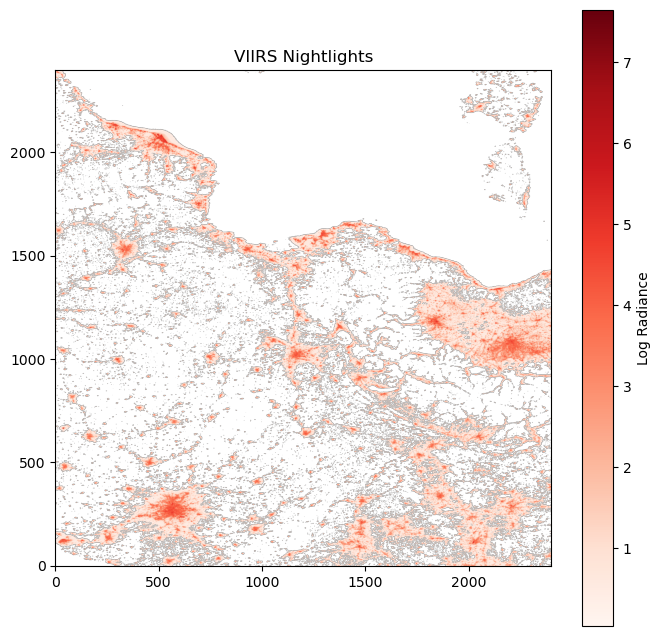

In [15]:
image = df_1.values

plt.figure(figsize=(8, 8))
plt.imshow(np.log1p(image), cmap="Reds", origin="lower")
plt.colorbar(label="Log Radiance")
plt.title("VIIRS Nightlights")
plt.show()

In [16]:
import h5py

folder_path_h5 = "VNP46A4_2-20260213_103212"

h5_path = "VNP46A4.A2021001.h18v04.002.2025149104200.h5"

file_path = os.path.join(folder_path_h5, h5_path)

with h5py.File(file_path, "r") as f:
    data = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"][:]
    lat = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/lat"][:]
    lon = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/lon"][:]

In [17]:
lon_grid, lat_grid = np.meshgrid(lon, lat)

print("Data shape:", data.shape)
print("Lat grid shape:", lat_grid.shape)
print("Lon grid shape:", lon_grid.shape)

Data shape: (2400, 2400)
Lat grid shape: (2400, 2400)
Lon grid shape: (2400, 2400)


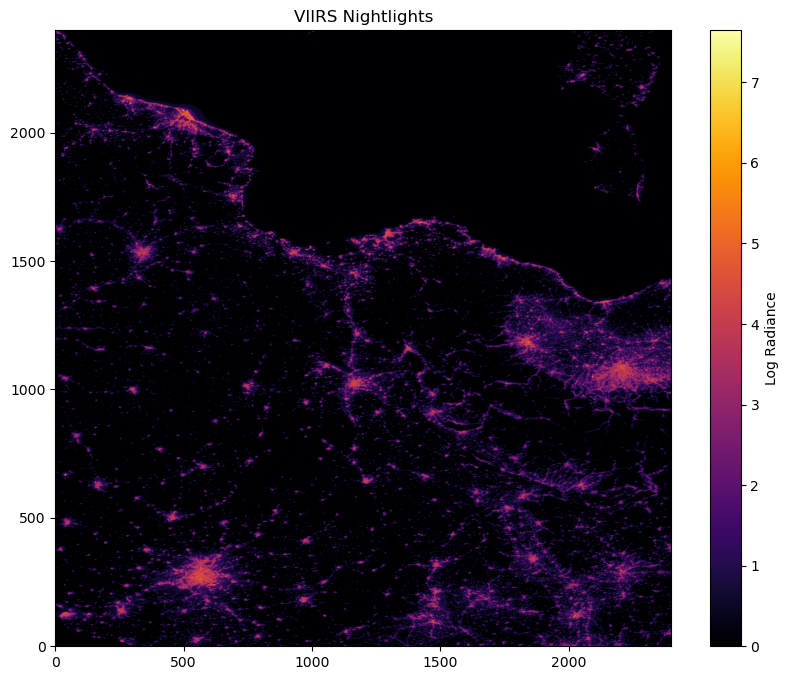

In [18]:
plt.figure(figsize=(10, 8))
plt.imshow(np.log1p(data), cmap="inferno", origin="lower")  # origin="lower" matches lat=0 at bottom
plt.colorbar(label="Log Radiance")
plt.title("VIIRS Nightlights")
plt.show()

#### Random pixel selected
( it represents the potential position of a bird observed and reported in ebird)

In [19]:
pixel_row = 700
pixel_col = 2300

latitude = lat_grid[pixel_row, pixel_col]
longitude = lon_grid[pixel_row, pixel_col]

print("Pixel coordinates:", pixel_row, pixel_col)
print("Latitude:", latitude, "Longitude:", longitude)

Pixel coordinates: 700 2300
Latitude: 47.08333333333101 Longitude: 9.58333333333311


In [20]:
# if the plot used origin="upper" (default in imshow), flip row index

#pixel_row = data.shape[0] - 1 - pixel_row

#### Total number of very bright pixels 
(based on the threshold)

In [21]:
threshold = 5  # log radiance threshold
bright_mask = np.log1p(data) > threshold

bright_lat = lat_grid[bright_mask]
bright_lon = lon_grid[bright_mask]

print("Number of bright pixels:", bright_lat.size)

Number of bright pixels: 403


#### Find the nearest bright pixel to the selected point
- km distance
- plot

In [22]:
from math import radians, cos, sin, asin, sqrt

def haversine(lat1, lon1, lat2, lon2):
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1)*cos(lat2)*sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    r = 6371  # km
    return c * r

# Example: distance from your random pixel to all bright pixels
lat_point = latitude
lon_point = longitude
distances = [haversine(lat_point, lon_point, lat, lon) for lat, lon in zip(bright_lat, bright_lon)]

nearest_distance = min(distances)
print("Nearest bright pixel distance (km):", nearest_distance)

Nearest bright pixel distance (km): 157.29971653315258


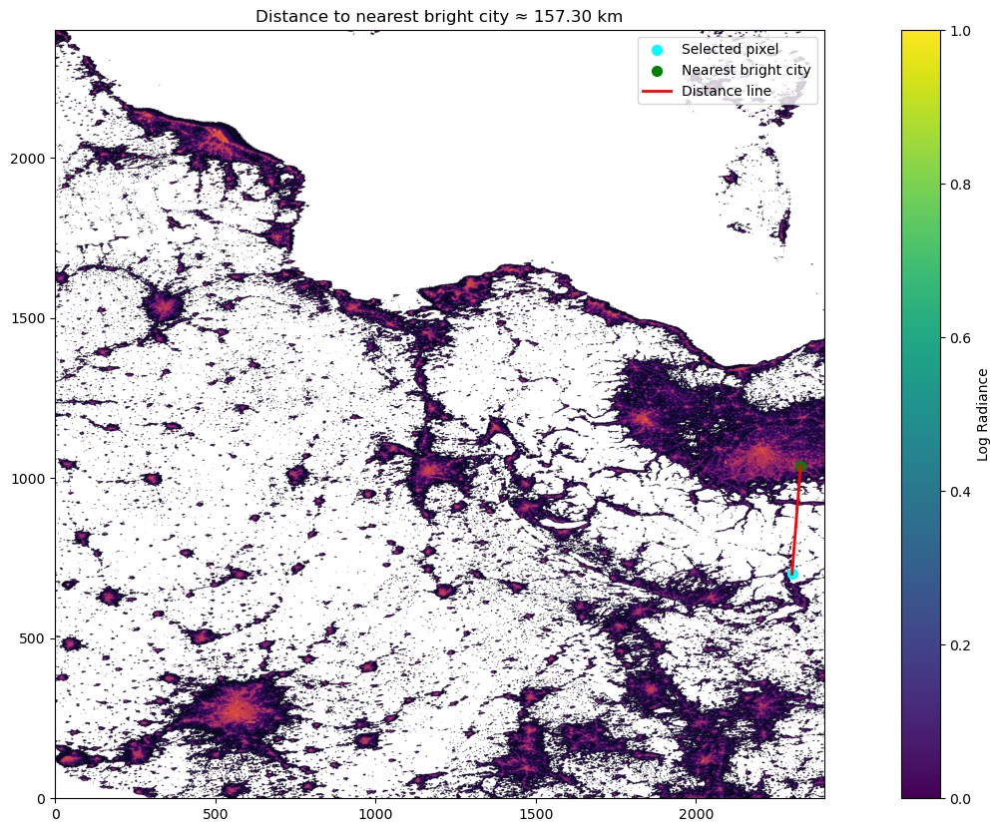

In [23]:
# image = your nightlight data, e.g., data from h5
# lat_grid, lon_grid = corresponding latitude/longitude grids
# lat_point, lon_point = your selected pixel coordinates
# bright_lat, bright_lon = coordinates of bright pixels
# nearest_distance = distance in km (optional)

# Find the nearest bright pixel
bright_coords = np.array(list(zip(bright_lat, bright_lon)))
distances = [haversine(lat_point, lon_point, lat, lon) for lat, lon in bright_coords]
nearest_idx = np.argmin(distances)
nearest_lat, nearest_lon = bright_coords[nearest_idx]

def find_pixel(lat_grid, lon_grid, lat_target, lon_target):
    """Return row, col of the pixel closest to (lat_target, lon_target)."""
    dist = (lat_grid - lat_target)**2 + (lon_grid - lon_target)**2
    i, j = np.unravel_index(np.argmin(dist), lat_grid.shape)
    return i, j

i_point, j_point = find_pixel(lat_grid, lon_grid, lat_point, lon_point)
i_nearest, j_nearest = find_pixel(lat_grid, lon_grid, nearest_lat, nearest_lon)

# Plot
plt.figure(figsize=(20, 10))
plt.imshow(np.log1p(image), cmap="inferno", origin="lower")

# Selected pixel
plt.scatter(j_point, i_point, color="cyan", s=50, label="Selected pixel")

# Nearest bright city
plt.scatter(j_nearest, i_nearest, color="green", s=50, label="Nearest bright city")

# Distance line
plt.plot([j_point, j_nearest], [i_point, i_nearest], color="red", linewidth=2, label="Distance line")

plt.colorbar(label="Log Radiance")
plt.legend()
plt.title(f"Distance to nearest bright city ≈ {nearest_distance:.2f} km")
plt.show()

In [24]:
print(lat_grid, lon_grid)

[[50.         50.         50.         ... 50.         50.
  50.        ]
 [49.99583333 49.99583333 49.99583333 ... 49.99583333 49.99583333
  49.99583333]
 [49.99166667 49.99166667 49.99166667 ... 49.99166667 49.99166667
  49.99166667]
 ...
 [40.0125     40.0125     40.0125     ... 40.0125     40.0125
  40.0125    ]
 [40.00833333 40.00833333 40.00833333 ... 40.00833333 40.00833333
  40.00833333]
 [40.00416667 40.00416667 40.00416667 ... 40.00416667 40.00416667
  40.00416667]] [[0.00000000e+00 4.16666667e-03 8.33333333e-03 ... 9.98750000e+00
  9.99166667e+00 9.99583333e+00]
 [0.00000000e+00 4.16666667e-03 8.33333333e-03 ... 9.98750000e+00
  9.99166667e+00 9.99583333e+00]
 [0.00000000e+00 4.16666667e-03 8.33333333e-03 ... 9.98750000e+00
  9.99166667e+00 9.99583333e+00]
 ...
 [0.00000000e+00 4.16666667e-03 8.33333333e-03 ... 9.98750000e+00
  9.99166667e+00 9.99583333e+00]
 [0.00000000e+00 4.16666667e-03 8.33333333e-03 ... 9.98750000e+00
  9.99166667e+00 9.99583333e+00]
 [0.00000000e+00 4.1

### Check the expantion of night lights 
- general insights
- select all files
- work only with one file
- check radiance distribution over years

#### Understand the files

In [25]:
folder_path_h5 = "VNP46A4_2-20260213_103212"

h5_path = "VNP46A4.A2021001.h18v04.002.2025149104200.h5"

file_path = os.path.join(folder_path_h5, h5_path)

with h5py.File(file_path, 'r') as f:
    print(list(f.keys()))

['HDFEOS', 'HDFEOS INFORMATION']


In [26]:
with h5py.File(file_path, 'r') as f:
    def print_structure(name):
        print(name)
    f.visit(print_structure)

HDFEOS
HDFEOS/ADDITIONAL
HDFEOS/ADDITIONAL/FILE_ATTRIBUTES
HDFEOS/GRIDS
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Covered
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Covered_Num
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Covered_Quality
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Covered_Std
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Num
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Quality
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Std
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/DNB_Platform
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/Land_Water_Mask
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/NearNadir_Composite_Snow_Covered
HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/

#### Read radiance layer

In [27]:
with h5py.File(file_path, 'r') as f:
    ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
    ntl = ds[:]
    
    # Apply scale factor if available
    scale = ds.attrs.get('scale_factor', 1)
    offset = ds.attrs.get('add_offset', 0)
    fill = ds.attrs.get('_FillValue')
    
    data = data * scale + offset

    if fill is not None:
        data[data == fill] = np.nan

print(np.nanmin(data), np.nanmax(data))

0.0 2088.206298828125


"AllAngle_Composite_Snow_Free" is the main VIIRS radiance dataset (nighttime lights)

- `data` now contains physical radiance values, e.g., nW/cm²/sr (nanoWatts per square cm per steradian)

Ouput:
- min: 0.0 (pixels with no light)
- max: 11.1765 (brightest pixel which we assume is a city center or industrial hotspot)

#### Dowload all 132 files

In [28]:
folder_path_h5 = "VNP46A4_2-20260213_103212"

files = sorted(glob.glob(os.path.join(folder_path_h5, "*.h5")))

print("Found", len(files), "files")
print(files[:3])

Found 132 files
['VNP46A4_2-20260213_103212\\VNP46A4.A2017001.h16v03.002.2025104183958.h5', 'VNP46A4_2-20260213_103212\\VNP46A4.A2017001.h16v04.002.2025104185717.h5', 'VNP46A4_2-20260213_103212\\VNP46A4.A2017001.h17v02.002.2025105145833.h5']


#### Work with only one file (the first file from the folder)

In [29]:
import h5py

with h5py.File(files[0], 'r') as f:
    mask = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/Land_Water_Mask"][:]

In [30]:
ntl = {}

for file in files:
    year = int(os.path.basename(file).split(".")[1][1:5])
    
    with h5py.File(file, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        
        data = ds[:] * ds.attrs.get('scale_factor', 1)
        fill = ds.attrs.get('_FillValue')
        
        if fill is not None:
            data[data == fill] = np.nan
            
        ntl[year] = data

print("Years loaded:", sorted(ntl.keys()))

Years loaded: [2017, 2018, 2019, 2020, 2021, 2022]


In [31]:
#check if all years align

for year in sorted(ntl):
    print(year, ntl[year].shape)

2017 (2400, 2400)
2018 (2400, 2400)
2019 (2400, 2400)
2020 (2400, 2400)
2021 (2400, 2400)
2022 (2400, 2400)


In [32]:
land = (mask == 1)

for year in ntl:
    ntl[year] = np.where(land, ntl[year], np.nan)

In [33]:
for year in ntl:
    ntl[year][ntl[year] < 1] = 0

In [34]:
threshold = 2 # check also 10

lit_area = {}

for year in ntl:
    lit_pixels = np.nansum(ntl[year] > threshold)
    lit_area[year] = lit_pixels

print(lit_area)

{2017: np.int64(274), 2018: np.int64(262), 2019: np.int64(283), 2020: np.int64(297), 2021: np.int64(321), 2022: np.int64(367)}


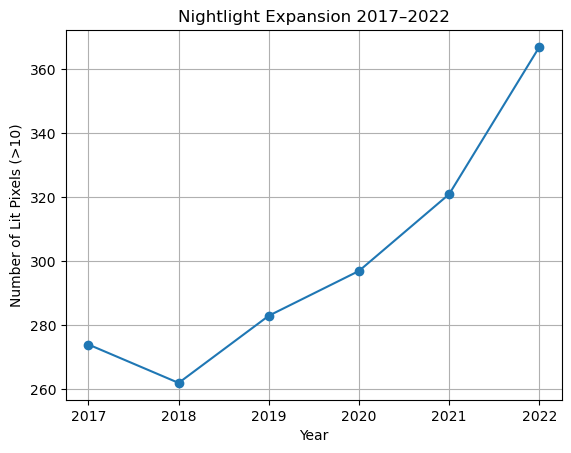

In [35]:
years = sorted(lit_area.keys())
values = [lit_area[y] for y in years]

plt.plot(years, values, marker="o")
plt.xlabel("Year")
plt.ylabel("Number of Lit Pixels (>10)")
plt.title("Nightlight Expansion 2017–2022")
plt.grid()
plt.show()

#### Check the radiance distribution over years

In [36]:
for year in sorted(ntl):
    print(year,
          "mean:", np.nanmean(ntl[year]),
          "max:", np.nanmax(ntl[year]))

2017 mean: 0.8016323821743829 max: 178.4095916748047
2018 mean: 0.7374798832194075 max: 157.21841430664062
2019 mean: 0.7297842975801478 max: 152.33401489257812
2020 mean: 0.7382007810297958 max: 122.58729553222656
2021 mean: 0.746949299142537 max: 132.58021545410156
2022 mean: 0.7979742577013564 max: 133.7909698486328


#### Check distribution for one year

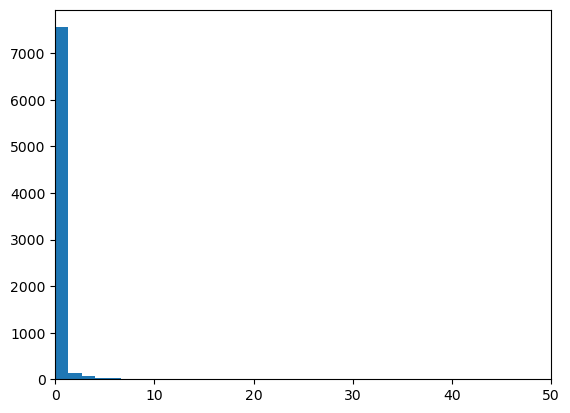

In [37]:
plt.hist(ntl[2021].flatten(), bins=100)
plt.xlim(0,50)
plt.show()

#### Check distribution for all years 
(+ apply log, since it is higly right skwed)

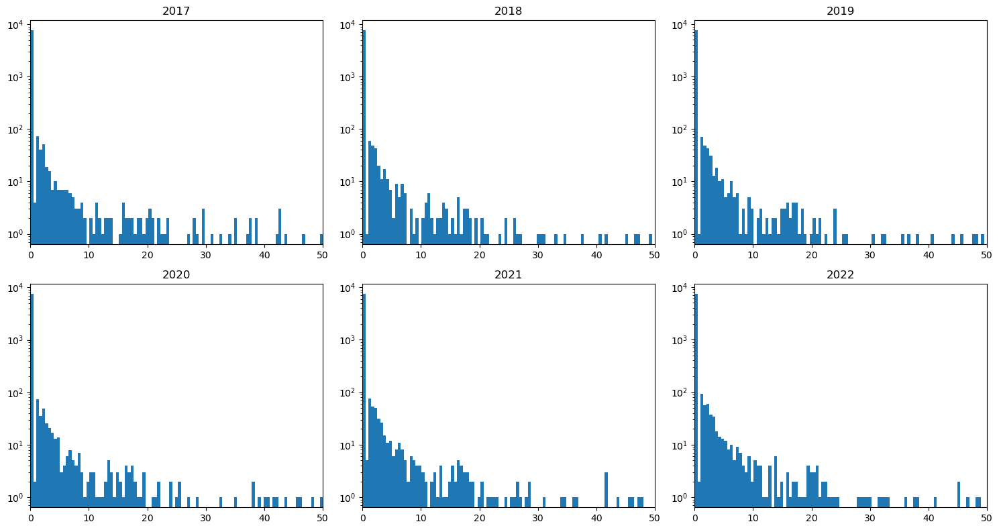

In [38]:
years = sorted(ntl.keys())

bins = np.linspace(0, 50, 100)

fig, axes = plt.subplots(2, 3, figsize=(15, 8))
axes = axes.flatten()

for i, year in enumerate(years):
    data = ntl[year]
    data = data[data >= 0]  # remove negatives if present
    
    axes[i].hist(data.flatten(), bins=bins)
    axes[i].set_xlim(0, 50)
    axes[i].set_yscale('log')
    axes[i].set_title(str(year))

plt.tight_layout()

#### Total expansion (years)

In [39]:
threshold = 5  # choose intensity threshold

for year in years:
    lit_pixels = np.sum(ntl[year] > threshold)
    print(year, "lit pixels:", lit_pixels)

2017 lit pixels: 162
2018 lit pixels: 152
2019 lit pixels: 154
2020 lit pixels: 158
2021 lit pixels: 174
2022 lit pixels: 191


In [40]:
for year in years:
    total = np.nansum(ntl[year])
    print(year, "total radiance:", total)

2017 total radiance: 6371.3741735219955
2018 total radiance: 5861.49011182785
2019 total radiance: 5800.325597167015
2020 total radiance: 5867.219807624817
2021 total radiance: 5936.753029584885
2022 total radiance: 6342.299400210381


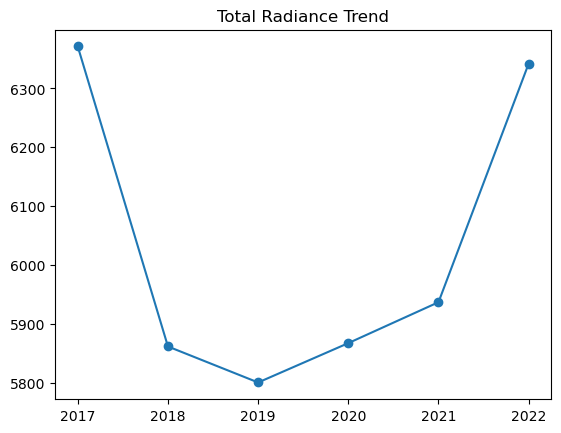

Radiance growth 2018–2022: 8.2 %


In [41]:
total_radiance = {year: np.nansum(ntl[year]) for year in ntl}

years = sorted(total_radiance)
values = [total_radiance[y] for y in years]

plt.plot(years, values, marker="o")
plt.title("Total Radiance Trend")
plt.show()

growth = (total_radiance[2022] - total_radiance[2018]) / total_radiance[2018] * 100
print("Radiance growth 2018–2022:", round(growth,2), "%")

In [42]:
total_pixels = ntl[2022].size

for year in sorted(ntl):
    lit = np.sum(ntl[year] > 5)
    percent = lit / total_pixels * 100
    print(year, f"{percent:.5f}%")

2017 0.00281%
2018 0.00264%
2019 0.00267%
2020 0.00274%
2021 0.00302%
2022 0.00332%


#### Not working !!!

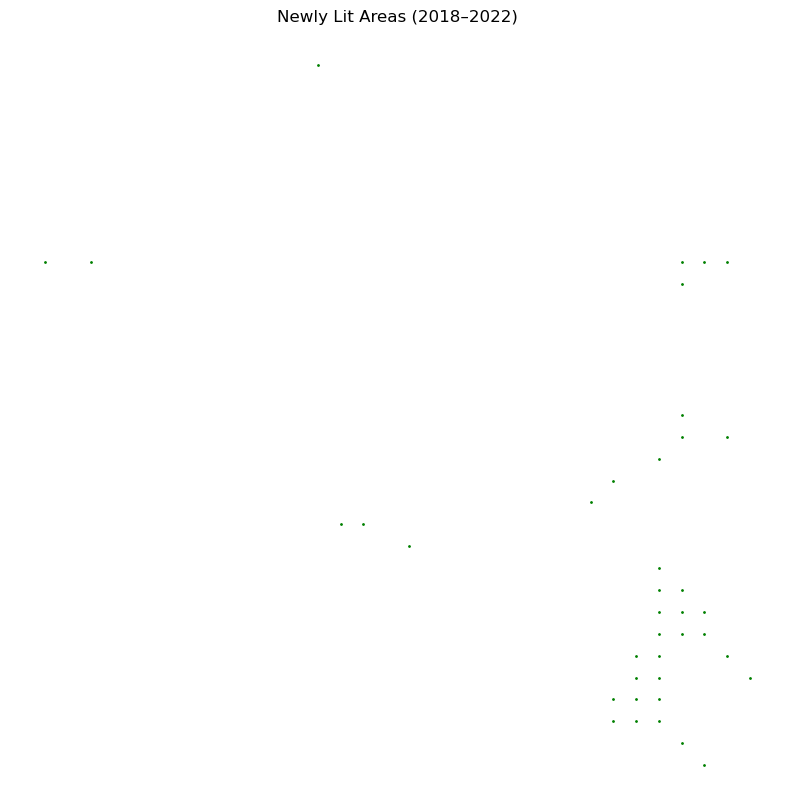

In [43]:
new_growth = (ntl[2022] > 5) & (ntl[2018] <= 5)

# Get coordinates
ys, xs = np.where(new_growth)

plt.figure(figsize=(10,10))
plt.scatter(xs, ys, s=1, c='green')  # s=1 pixel size
plt.title("Newly Lit Areas (2018–2022)")
plt.gca().invert_yaxis()  # optional to match raster orientation
plt.axis('off')
plt.show()

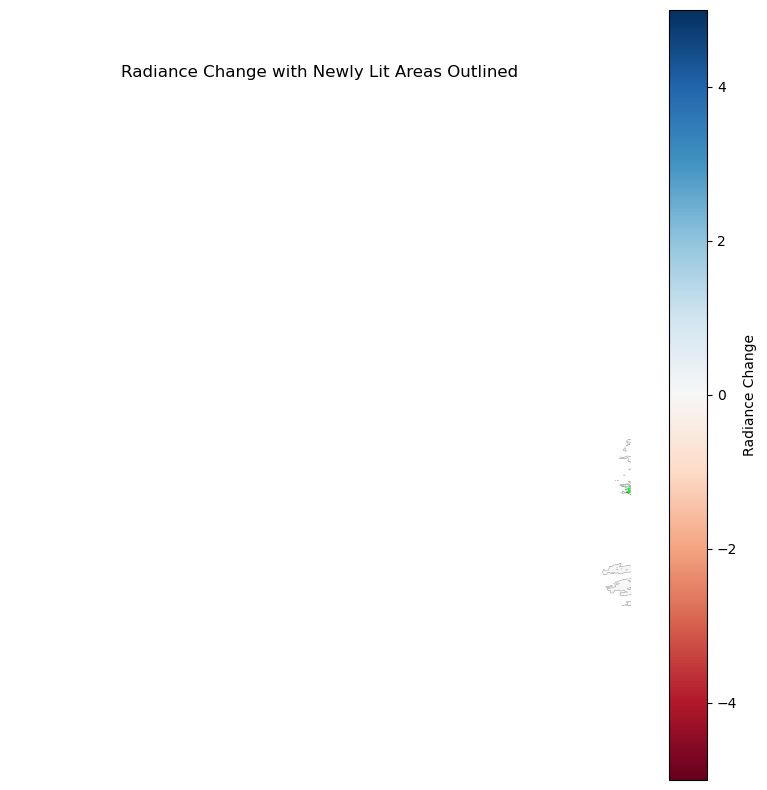

In [44]:
import matplotlib.pyplot as plt

change = ntl[2022] - ntl[2018]
new_growth = (ntl[2022] > 5) & (ntl[2018] <= 5)

plt.figure(figsize=(10,10))

# Keep a reference to the imshow object
im = plt.imshow(change, cmap='RdBu', vmin=-5, vmax=5)

# Overlay newly lit pixels as contour
plt.contour(new_growth.astype(int), levels=[0.5, 1], colors='lime', linewidths=0.5)


# Attach colorbar to the imshow object
plt.colorbar(im, label="Radiance Change")

plt.title("Radiance Change with Newly Lit Areas Outlined")
plt.axis('off')
plt.show()

C:\Users\Radu\AppData\Local\Temp\ipykernel_17620\3708392517.py:4: UserWarning: Adding colorbar to a different Figure <Figure size 1000x1000 with 3 Axes> than <Figure size 640x480 with 1 Axes> which fig.colorbar is called on.
  plt.colorbar(im, label="Radiance Change")


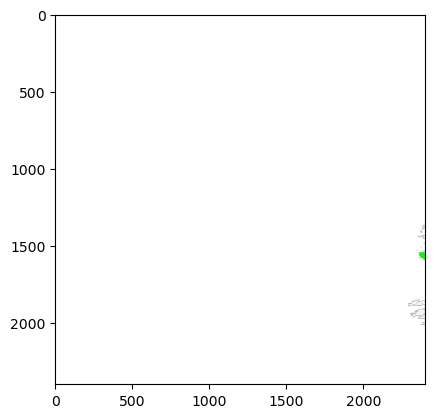

In [45]:
ys, xs = np.where(new_growth)
plt.imshow(change, cmap='RdBu', vmin=-5, vmax=5)
plt.scatter(xs, ys, s=1, c='lime')
plt.colorbar(im, label="Radiance Change")
plt.show()

### Check the nightlights expansion or decline for one area

#### Plot

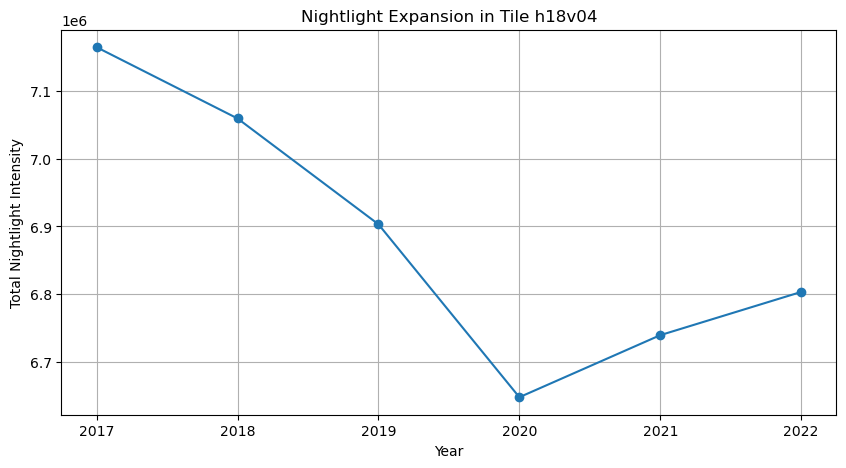

Nr of files analyzed: 6


In [46]:
import os
import h5py
import numpy as np
import matplotlib.pyplot as plt

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h18v04"  # the area/tile you care about(we only want the one for tile h18v04 = area that we want)

# loop all files => each year
h5_files = sorted([
    f for f in os.listdir(folder_path_h5)
    if f.endswith(".h5") and tile_code in f
])

ntl_sums = []
years = []
c = 0
for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)

    c+=1
    
    # extract year from filename
    year = int(h5_file.split(".")[1][1:5])
    years.append(year)
    
    # nightlights data
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        # apply scale and offset (many satellite datasets store data as integers. scale_factor and add_offset convert raw values to real brightness values)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        
        # sum or mean to get a single value for this year/tile
        ntl_sums.append(np.nansum(ntl)) # sum all valid nightlight values => the total nightlight intensity

# Plot the time series
plt.figure(figsize=(10, 5))
plt.plot(years, ntl_sums, marker='o')
plt.xlabel("Year")
plt.ylabel("Total Nightlight Intensity")
plt.title(f"Nightlight Expansion in Tile {tile_code}")
plt.grid(True)
plt.show()
print("Nr of files analyzed:",c)


2017 $\rightarrow$ 2019 $\Rightarrow$ decrease in total intensity

2020 $\rightarrow$ the lowest intensity (COVID ???)

2021 $\rightarrow$ 2022 $\Rightarrow$ increases (or recovers back to the inital situation or based on what we saw previously actully it might increase drastically)

#### Check radiance growth

In [47]:
ntl_sums = np.array(ntl_sums)  # Convert list to array for math

# Percentage change year-to-year
pct_change = (ntl_sums[1:] - ntl_sums[:-1]) / ntl_sums[:-1] * 100

for i, change in enumerate(pct_change):
    print(f"{years[i]} => {years[i+1]}: {change:.2f} % change")

2017 => 2018: -1.47 % change
2018 => 2019: -2.21 % change
2019 => 2020: -3.70 % change
2020 => 2021: 1.38 % change
2021 => 2022: 0.95 % change


In [48]:
growth_from_start = ntl_sums - ntl_sums[0]

for i, g in enumerate(growth_from_start):
    print(f"{years[i]}: {g:.2f} total radiance growth since {years[0]}")

2017: 0.00 total radiance growth since 2017
2018: -105228.38 total radiance growth since 2017
2019: -261535.17 total radiance growth since 2017
2020: -516952.86 total radiance growth since 2017
2021: -425290.99 total radiance growth since 2017
2022: -361447.56 total radiance growth since 2017


2017 = 0.00 is the baseline year

Negative values: each year after 2017 shows a decrease in total radiance compared to 2017

Ex.: 
- in 2018 the area emitted 105228 fewer radiance units than in 2017
- in 2020 the drop is the biggest $\rightarrow$ -516952.86 units ( $\approx$ 50% reduction)

There is a declining trend in total nightlight intensity from 2017 to 2022, with the largest drop in 2020. After 2020, there is some recovery, but still below 2017.

Causes:
- economic downturns or population migration, bc of less energy use, so fewer lights
- 2020 could reflect COVID19 lockdown effects or reduced industrial activity.

#### Not working !!!!

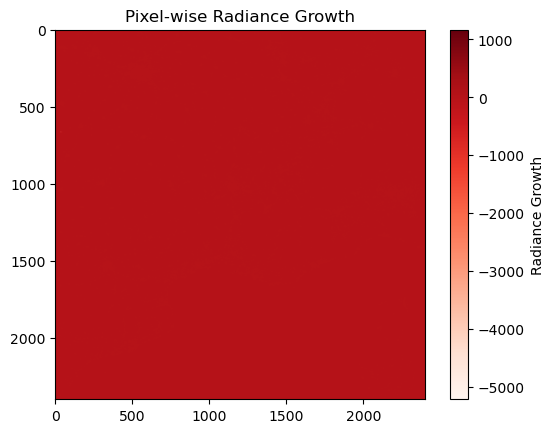

In [49]:
with h5py.File(os.path.join(folder_path_h5, h5_files[-1]), 'r') as f:
    last_year = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"][:].astype(float)

with h5py.File(os.path.join(folder_path_h5, h5_files[0]), 'r') as f:
    first_year = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"][:].astype(float)

# Apply scale/offset/fill for both (same as before)

radiance_growth = last_year - first_year  # positive = growth

plt.imshow(radiance_growth, cmap="Reds")
plt.colorbar(label="Radiance Growth")
plt.title("Pixel-wise Radiance Growth")
plt.show()

### Check the nightlights expansion or decline for all areas

#### Aggregate all areas 

Found tiles: ['h16v03', 'h16v04', 'h17v02', 'h17v03', 'h17v04', 'h17v05', 'h18v02', 'h18v03', 'h18v04', 'h18v05', 'h19v02', 'h19v03', 'h19v04', 'h19v05', 'h20v01', 'h20v02', 'h20v03', 'h20v04', 'h20v05', 'h21v02', 'h21v03', 'h21v04']


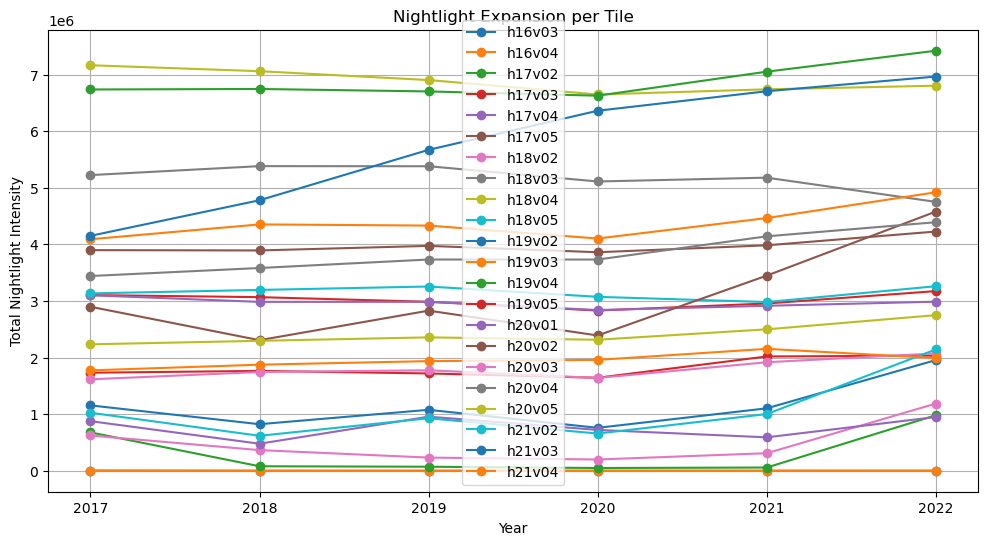

Tile h16v03: 6 files analyzed
Tile h16v04: 6 files analyzed
Tile h17v02: 6 files analyzed
Tile h17v03: 6 files analyzed
Tile h17v04: 6 files analyzed
Tile h17v05: 6 files analyzed
Tile h18v02: 6 files analyzed
Tile h18v03: 6 files analyzed
Tile h18v04: 6 files analyzed
Tile h18v05: 6 files analyzed
Tile h19v02: 6 files analyzed
Tile h19v03: 6 files analyzed
Tile h19v04: 6 files analyzed
Tile h19v05: 6 files analyzed
Tile h20v01: 6 files analyzed
Tile h20v02: 6 files analyzed
Tile h20v03: 6 files analyzed
Tile h20v04: 6 files analyzed
Tile h20v05: 6 files analyzed
Tile h21v02: 6 files analyzed
Tile h21v03: 6 files analyzed
Tile h21v04: 6 files analyzed


In [50]:
folder_path_h5 = "VNP46A4_2-20260213_103212"

# Get all HDF5 files in the folder
h5_files = sorted([f for f in os.listdir(folder_path_h5) if f.endswith(".h5")])

# Identify all unique tiles from filenames, e.g., h18v04
tiles = sorted({f.split(".")[2] for f in h5_files})  # tile is the 3rd part in filename

print("Found tiles:", tiles)

# Store results
results = {tile: {"years": [], "ntl_sums": []} for tile in tiles}

# Loop over files
for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    
    # Extract tile and year from filename
    tile = h5_file.split(".")[2]
    year = int(h5_file.split(".")[1][1:5])
    
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        # Apply scale and offset
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        
        # Sum all valid nightlight values
        ntl_sum = np.nansum(ntl)
        
        # Append to results for this tile
        results[tile]["years"].append(year)
        results[tile]["ntl_sums"].append(ntl_sum)

# Plot results for all tiles
plt.figure(figsize=(12, 6))
for tile, data in results.items():
    plt.plot(data["years"], data["ntl_sums"], marker='o', label=tile)

plt.xlabel("Year")
plt.ylabel("Total Nightlight Intensity")
plt.title("Nightlight Expansion per Tile")
plt.legend()
plt.grid(True)
plt.show()

# Print summary
for tile, data in results.items():
    print(f"Tile {tile}: {len(data['years'])} files analyzed")

#### Each area separate

Found tiles: ['h16v03', 'h16v04', 'h17v02', 'h17v03', 'h17v04', 'h17v05', 'h18v02', 'h18v03', 'h18v04', 'h18v05', 'h19v02', 'h19v03', 'h19v04', 'h19v05', 'h20v01', 'h20v02', 'h20v03', 'h20v04', 'h20v05', 'h21v02', 'h21v03', 'h21v04']


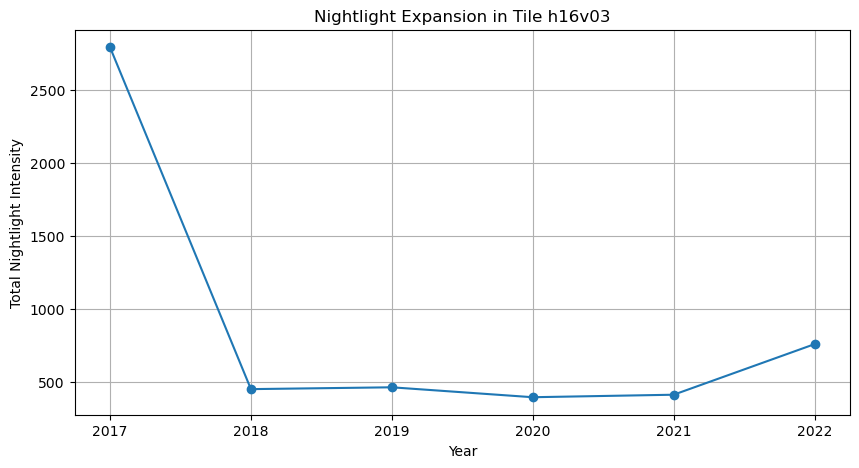

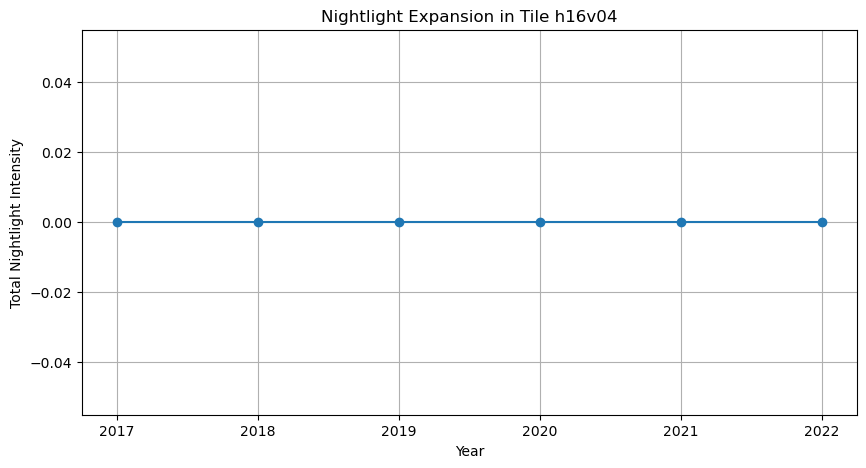

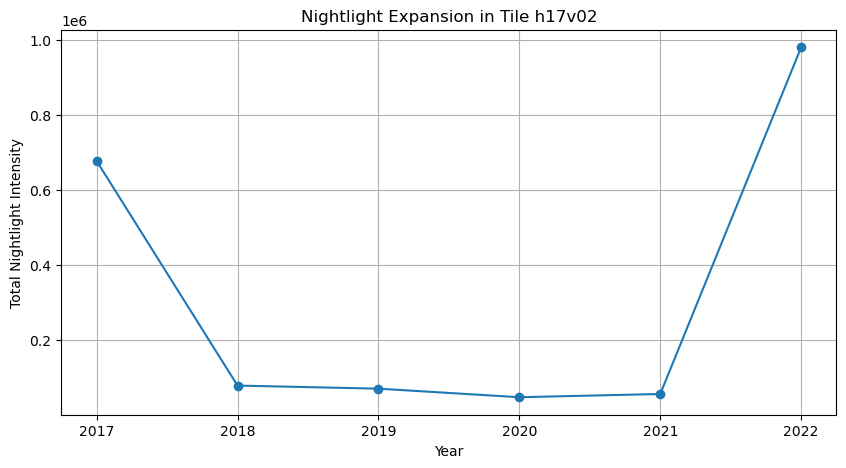

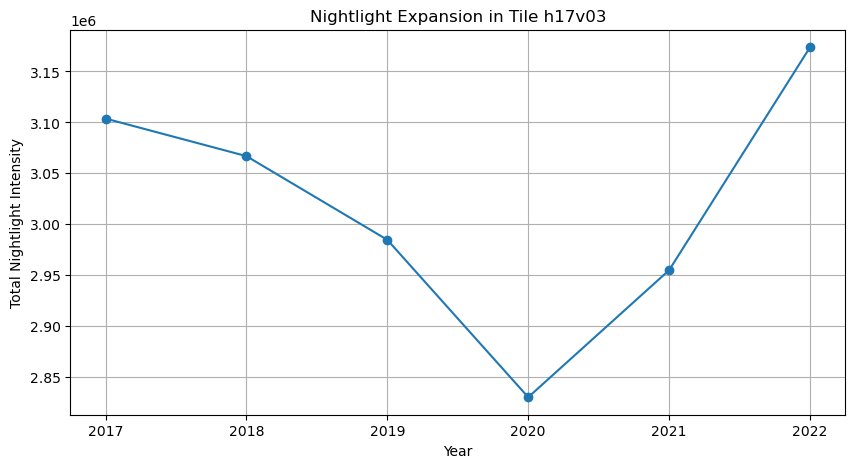

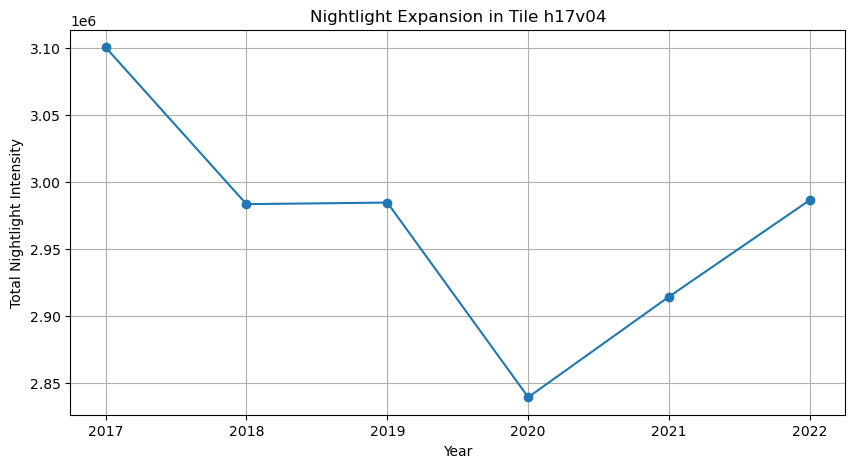

...

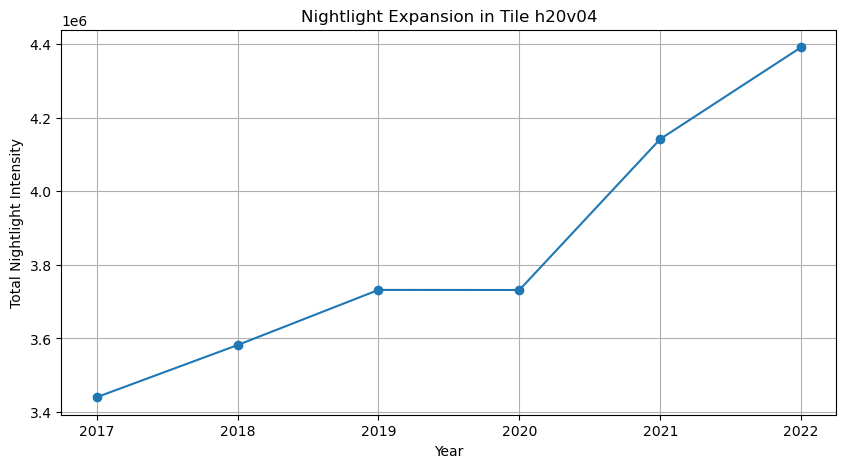

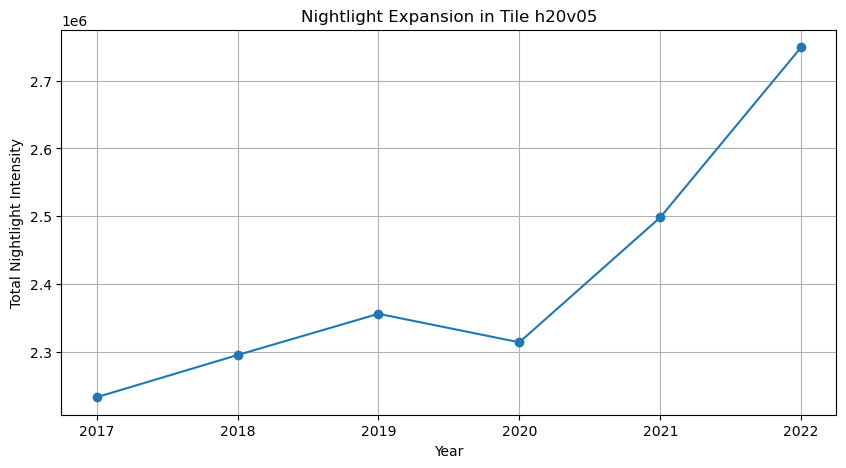

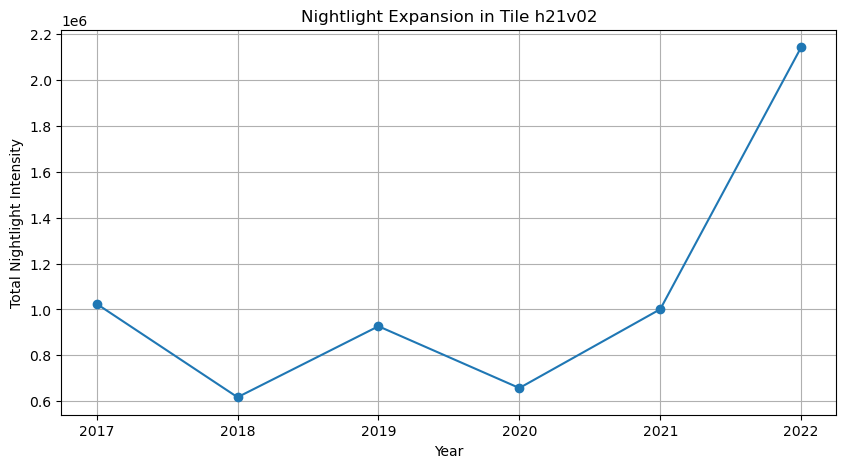

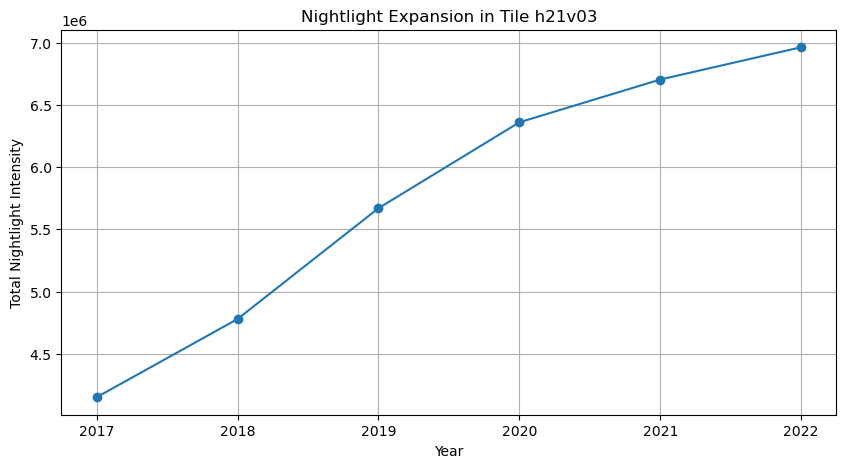

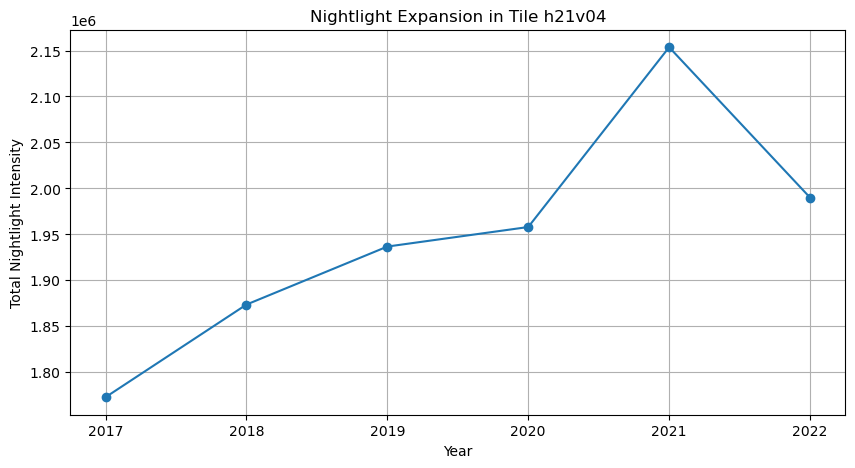

Tile h16v03: 6 files analyzed
Tile h16v04: 6 files analyzed
Tile h17v02: 6 files analyzed
Tile h17v03: 6 files analyzed
Tile h17v04: 6 files analyzed
Tile h17v05: 6 files analyzed
Tile h18v02: 6 files analyzed
Tile h18v03: 6 files analyzed
Tile h18v04: 6 files analyzed
Tile h18v05: 6 files analyzed
Tile h19v02: 6 files analyzed
Tile h19v03: 6 files analyzed
Tile h19v04: 6 files analyzed
Tile h19v05: 6 files analyzed
Tile h20v01: 6 files analyzed
Tile h20v02: 6 files analyzed
Tile h20v03: 6 files analyzed
Tile h20v04: 6 files analyzed
Tile h20v05: 6 files analyzed
Tile h21v02: 6 files analyzed
Tile h21v03: 6 files analyzed
Tile h21v04: 6 files analyzed


In [51]:
folder_path_h5 = "VNP46A4_2-20260213_103212"

# Get all HDF5 files in the folder
h5_files = sorted([f for f in os.listdir(folder_path_h5) if f.endswith(".h5")])

# Identify all unique tiles from filenames, e.g., h18v04
tiles = sorted({f.split(".")[2] for f in h5_files})  # tile is the 3rd part in filename
print("Found tiles:", tiles)

# Store results
results = {tile: {"years": [], "ntl_sums": []} for tile in tiles}

# Loop over files
for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    
    # Extract tile and year from filename
    tile = h5_file.split(".")[2]
    year = int(h5_file.split(".")[1][1:5])
    
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        # Apply scale and offset
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        
        # Sum all valid nightlight values
        ntl_sum = np.nansum(ntl)
        
        # Append to results for this tile
        results[tile]["years"].append(year)
        results[tile]["ntl_sums"].append(ntl_sum)

# Create separate plots per tile
for tile, data in results.items():
    plt.figure(figsize=(10, 5))
    plt.plot(data["years"], data["ntl_sums"], marker='o')
    plt.xlabel("Year")
    plt.ylabel("Total Nightlight Intensity")
    plt.title(f"Nightlight Expansion in Tile {tile}")
    plt.grid(True)
    plt.show()  # display the plot
    # Optional: save each plot as image
    # plt.savefig(f"nightlights_{tile}.png")
    plt.close()

# Print summary
for tile, data in results.items():
    print(f"Tile {tile}: {len(data['years'])} files analyzed")

### Check area based on coordinates and images

#### Coordinates

In [52]:
def tile_bounds(tile_hv):
    """
    Returns approximate lat/lon bounds (degrees) for a MODIS tile.
    tile_hv: string like "h18v04"
    """
    h = int(tile_hv[1:3])
    v = int(tile_hv[4:6])  # <-- skip the 'v'
    
    tile_size_km = 1200  # MODIS sinusoidal tile ~1200 km
    earth_radius_km = 6371
    km_per_deg_lat = 2 * np.pi * earth_radius_km / 360
    km_per_deg_lon = km_per_deg_lat  # approximation
    
    lon_min = -180 + h * tile_size_km / km_per_deg_lon
    lon_max = lon_min + tile_size_km / km_per_deg_lon
    lat_max = 90 - v * tile_size_km / km_per_deg_lat
    lat_min = lat_max - tile_size_km / km_per_deg_lat
    
    return lon_min, lon_max, lat_min, lat_max


In [83]:
# example

tiles = ["h18v04"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

Tile h18v04 bounds:
Longitude: 14.25 → 25.05
Latitude: 36.04 → 46.83



#### For h18v04 (france, elvetia, italia o parte) $\rightarrow$ plot bun

In [54]:
tile = "h18v04"
lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
print(f"Tile {tile} bounds:")
print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}")

Tile h18v04 bounds:
Longitude: 14.25 → 25.05
Latitude: 36.04 → 46.83


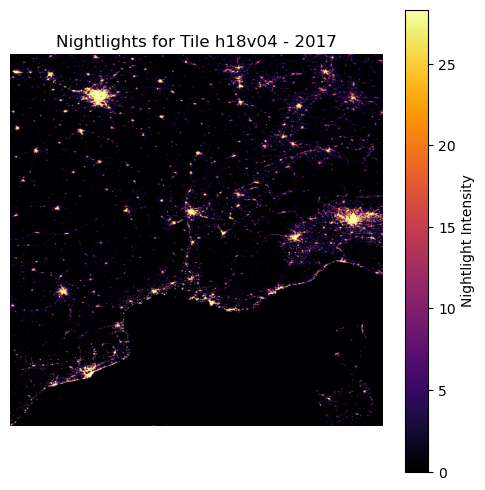

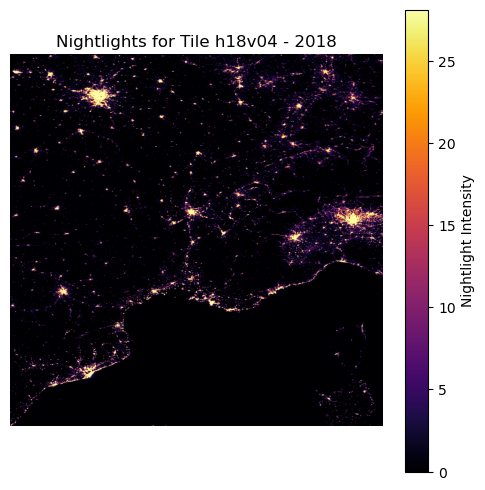

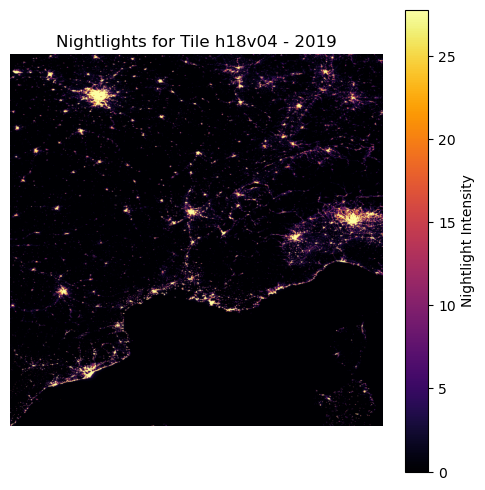

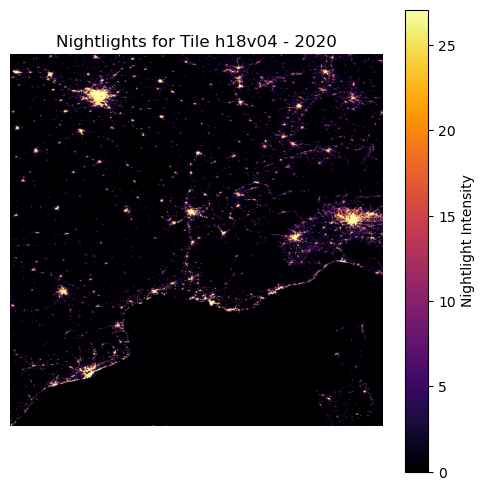

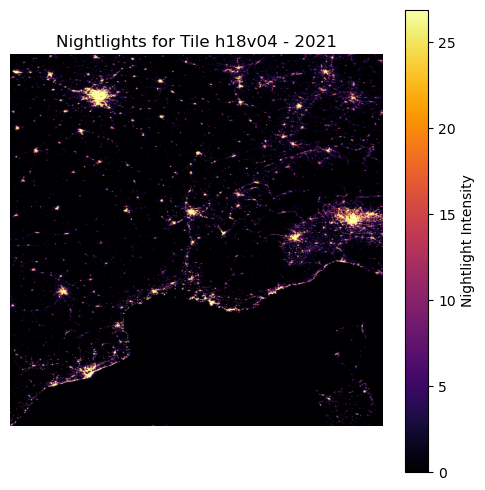

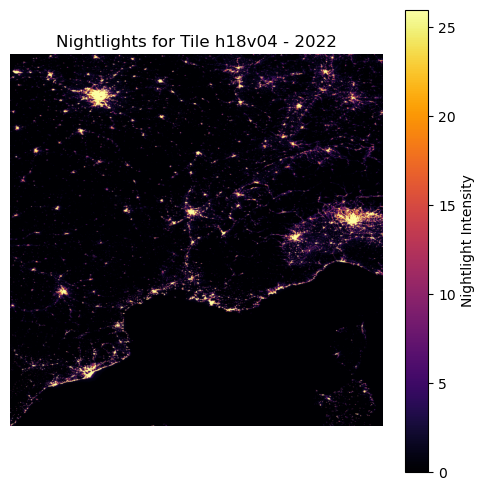

In [55]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h18v04"

h5_files = sorted([f for f in os.listdir(folder_path_h5) if f.endswith(".h5") and tile_code in f])

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    year = int(h5_file.split(".")[1][1:5])
    
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
    
    # Optional: clip extreme outliers for better visualization
    vmax = np.nanpercentile(ntl, 99)  # 99th percentile
    vmin = np.nanmin(ntl)
    
    plt.figure(figsize=(6,6))
    plt.imshow(ntl, cmap='inferno', origin='upper', vmin=vmin, vmax=vmax)
    plt.colorbar(label='Nightlight Intensity')
    plt.title(f'Nightlights for Tile {tile_code} - {year}')
    plt.axis('off')
    plt.show()

#### Expansion difference h18v04

In [106]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h18v04"

def load_year(year):
    # Find file for that year
    file = [f for f in os.listdir(folder_path_h5)
            if f.endswith(".h5") and tile_code in f and f"A{year}" in f][0]
    
    file_path = os.path.join(folder_path_h5, file)
    
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
    
    return ntl

# Load both years
ntl_2017 = load_year(2017)
ntl_2022 = load_year(2022)

# Compute difference
diff = ntl_2022 - ntl_2017

In [108]:
print("Min diff:", np.nanmin(diff))
print("Max diff:", np.nanmax(diff))
print("Mean diff:", np.nanmean(diff))

Min diff: -5211.884902954102
Max diff: 1168.650405883789
Mean diff: -0.06275131239227841


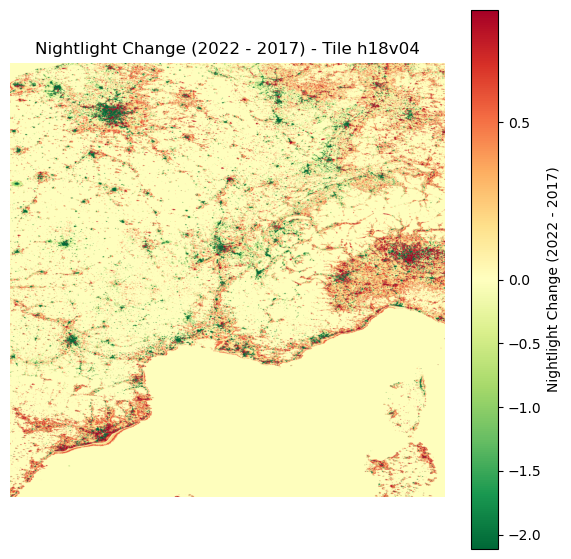

In [110]:
from matplotlib.colors import TwoSlopeNorm

# Clip extreme outliers
low = np.nanpercentile(diff, 2)
high = np.nanpercentile(diff, 98)

norm = TwoSlopeNorm(vmin=low, vcenter=0, vmax=high)

plt.figure(figsize=(7,7))
plt.imshow(diff, cmap='RdYlGn_r', norm=norm)
plt.colorbar(label='Nightlight Change (2022 - 2017)')
plt.title(f'Nightlight Change (2022 - 2017) - Tile {tile_code}')
plt.axis('off')
plt.show()

In [115]:
ntl_2017 = np.log1p(ntl_2017)
ntl_2022 = np.log1p(ntl_2022)
diff = ntl_2022 - ntl_2017

diff = (ntl_2022 - ntl_2017) / (ntl_2017 + 1)
diff

array([[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [ 0.00142315, -0.00120538,  0.00266334, ...,  0.        ,
         0.        ,  0.        ],
       [-0.00242754, -0.00623403, -0.00474767, ...,  0.        ,
         0.        ,  0.        ],
       [-0.00250143, -0.00527762, -0.00787115, ...,  0.        ,
         0.        ,  0.        ]], shape=(2400, 2400))

#### For h18v03 $\rightarrow$ NL plot ciudat, decadere mare in 2022

In [56]:
tile = "h18v03"
lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
print(f"Tile {tile} bounds:")
print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}")

Tile h18v03 bounds:
Longitude: 14.25 → 25.05
Latitude: 46.83 → 57.62


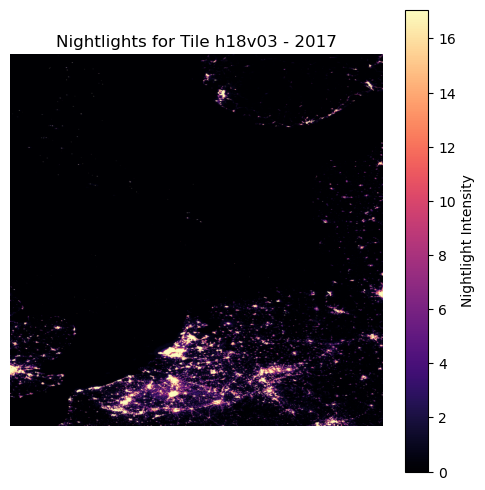

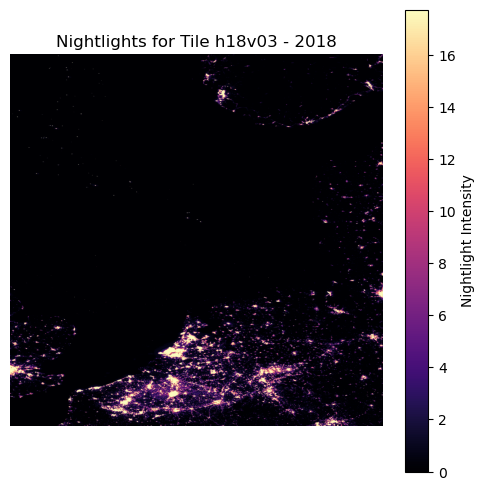

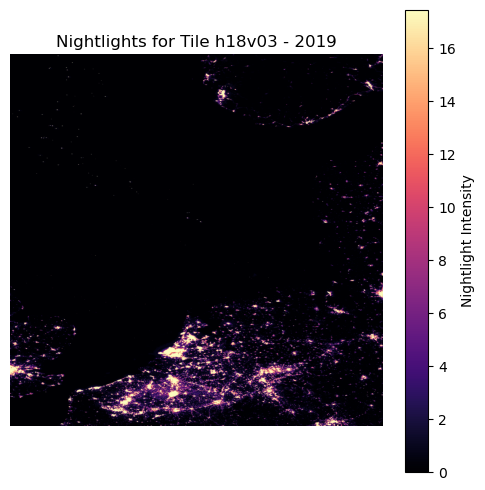

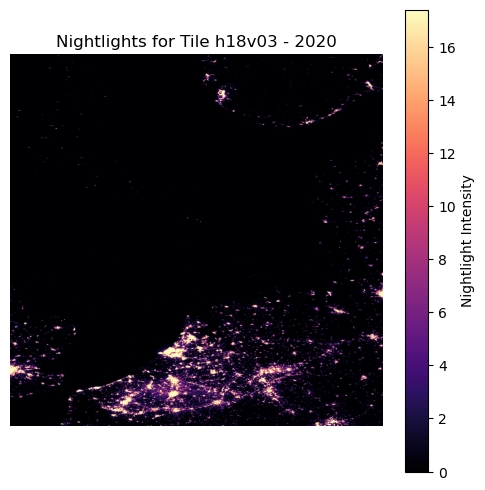

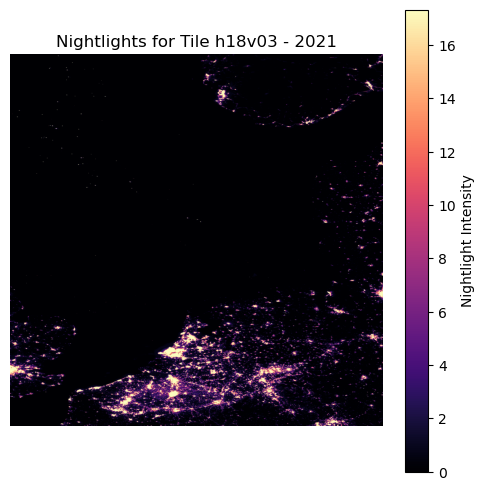

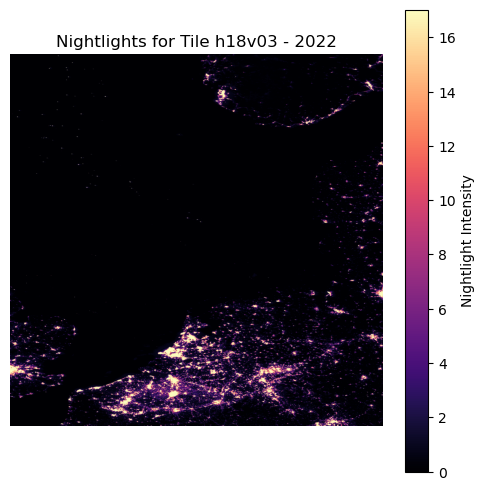

In [57]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h18v03"

h5_files = sorted([f for f in os.listdir(folder_path_h5) if f.endswith(".h5") and tile_code in f])

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    year = int(h5_file.split(".")[1][1:5])
    
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
    
    # Optional: clip extreme outliers for better visualization
    vmax = np.nanpercentile(ntl, 99)  # 99th percentile
    vmin = np.nanmin(ntl)
    
    plt.figure(figsize=(6,6))
    plt.imshow(ntl, cmap='magma', origin='upper', vmin=vmin, vmax=vmax)
    plt.colorbar(label='Nightlight Intensity')
    plt.title(f'Nightlights for Tile {tile_code} - {year}')
    plt.axis('off')
    plt.show()

#### h17v05

In [58]:
tile = "h17v05"
lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
print(f"Tile {tile} bounds:")
print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}")

Tile h17v05 bounds:
Longitude: 3.46 → 14.25
Latitude: 25.25 → 36.04


C:\Users\Radu\AppData\Local\Temp\ipykernel_17620\1599517657.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


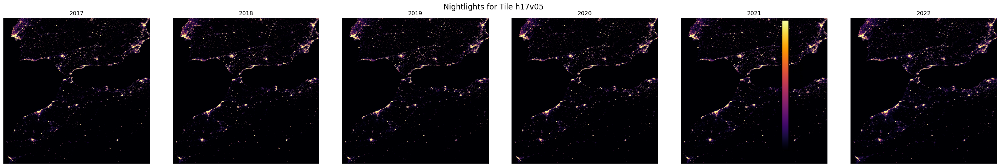

In [59]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h17v05"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])

n = len(h5_files)

# Define subplot grid automatically
cols = 6  # change if you want more columns
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
axes = axes.flatten()  # flatten in case of multiple rows

for i, h5_file in enumerate(h5_files):
    file_path = os.path.join(folder_path_h5, h5_file)
    year = int(h5_file.split(".")[1][1:5])
    
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
    
    vmax = np.nanpercentile(ntl, 99)
    vmin = np.nanmin(ntl)
    
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper',
                        vmin=vmin, vmax=vmax)
    axes[i].set_title(f'{year}')
    axes[i].axis('off')

# Remove empty subplots if any
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Add one shared colorbar
fig.colorbar(im, ax=axes.tolist(), label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.tight_layout()
plt.show()

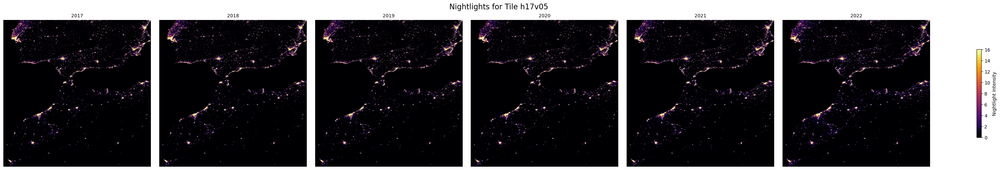

In [60]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h17v05"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h16v03 !!!!!!

In [61]:
tiles = ["h16v03"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

Tile h16v03 bounds:
Longitude: -7.33 → 3.46
Latitude: 46.83 → 57.62



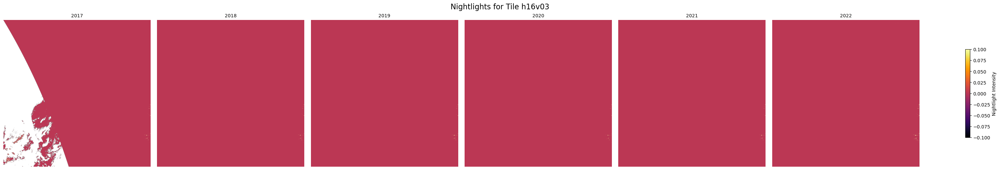

In [62]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h16v03"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h16v-4 !!!!!!!

In [63]:
tiles = ["h16v04"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

Tile h16v04 bounds:
Longitude: -7.33 → 3.46
Latitude: 36.04 → 46.83



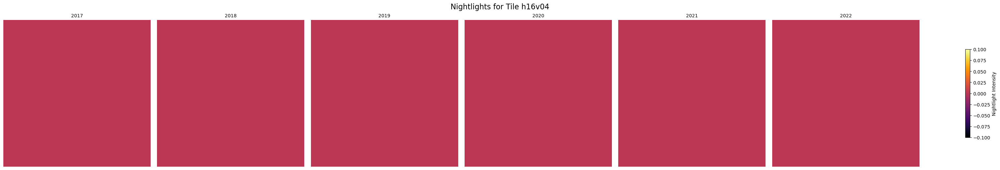

In [64]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h16v04"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h17v02

In [65]:
tiles = ["h17v02"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

Tile h17v02 bounds:
Longitude: 3.46 → 14.25
Latitude: 57.62 → 68.42



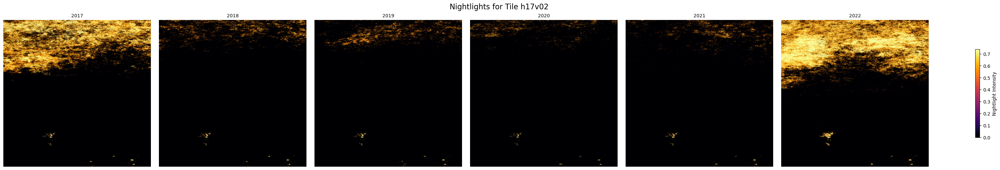

In [66]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h17v02"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h17v03

Tile h17v03 bounds:
Longitude: 3.46 → 14.25
Latitude: 46.83 → 57.62



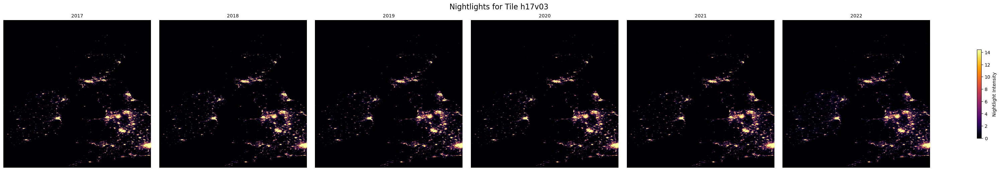

In [68]:
tiles = ["h17v03"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h17v03"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h17v04

Tile h17v04 bounds:
Longitude: 3.46 → 14.25
Latitude: 36.04 → 46.83



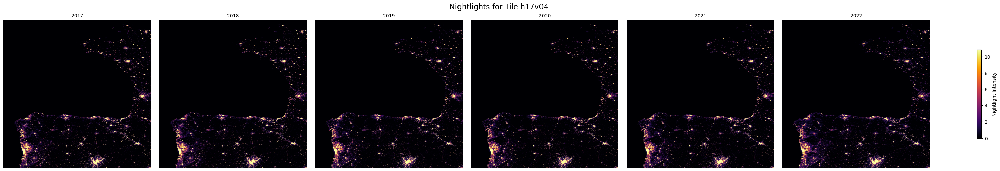

In [67]:
tiles = ["h17v04"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h17v04"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h18v02 !!!!

Tile h18v02 bounds:
Longitude: 14.25 → 25.05
Latitude: 57.62 → 68.42



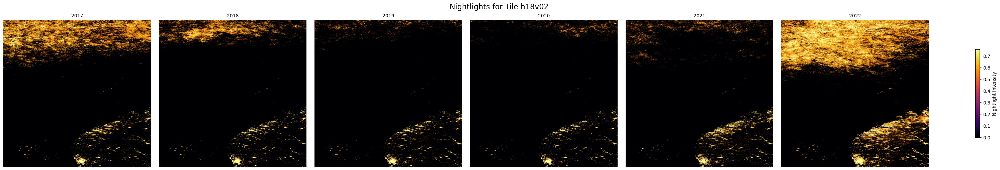

In [97]:
tiles = ["h18v02"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h18v02"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

`Stray light contamination`

Sunlight scattering during:
- Twilight
- Low sun angles
- Polar night transitions

Even though VNP46A4 applies correction, residual artifacts remain

##### fix problem with the wierd orange color in the ocean (not working tho)

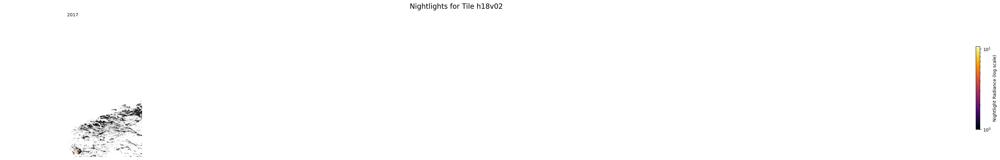

In [99]:
all_ntl_values = []
all_valid_pixels = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        # Load radiance and observation count
        ds_ntl = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ds_num = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Num"]
        ds_lw = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/Land_Water_Mask"]

        ntl = ds_ntl[:].astype(float)
        num = ds_num[:].astype(float)
        lw = ds_lw[:]

        scale = ds_ntl.attrs.get('scale_factor', 1)
        offset = ds_ntl.attrs.get('add_offset', 0)
        fill = ds_ntl.attrs.get('_FillValue')

        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan

        # Mask low observations
        ntl[num < 5] = np.nan

        # Mask water
        ntl[lw != 1] = np.nan

        # Remove zeros / negatives for log scale
        ntl[ntl <= 0] = np.nan
        ntl_masked = ntl.copy()
        ntl_masked[lw != 1] = np.nan      # Mask water
        ntl_masked[ntl_masked < 0.01] = 0.01  # Avoid zeros for log scale

all_ntl_values.append(ntl)
all_valid_pixels.append(ntl.flatten())
all_concat = np.concatenate([arr[arr>0].flatten() for arr in all_ntl_values])
vmin = np.min(all_concat)
vmax = np.nanpercentile(all_concat, 99)  # keeps brightest pixels from saturating
norm = LogNorm(vmin=vmin, vmax=vmax)

# Compute global log scale limits
all_concat = np.concatenate(all_valid_pixels)
all_concat = all_concat[~np.isnan(all_concat)]
vmin = 1
vmax = np.nanpercentile(all_concat, 99)
norm = LogNorm(vmin=vmin, vmax=vmax)

# Plot all years
fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty axes
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6)
cbar.set_label("Nightlight Radiance (log scale)")

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

##### now working :)))

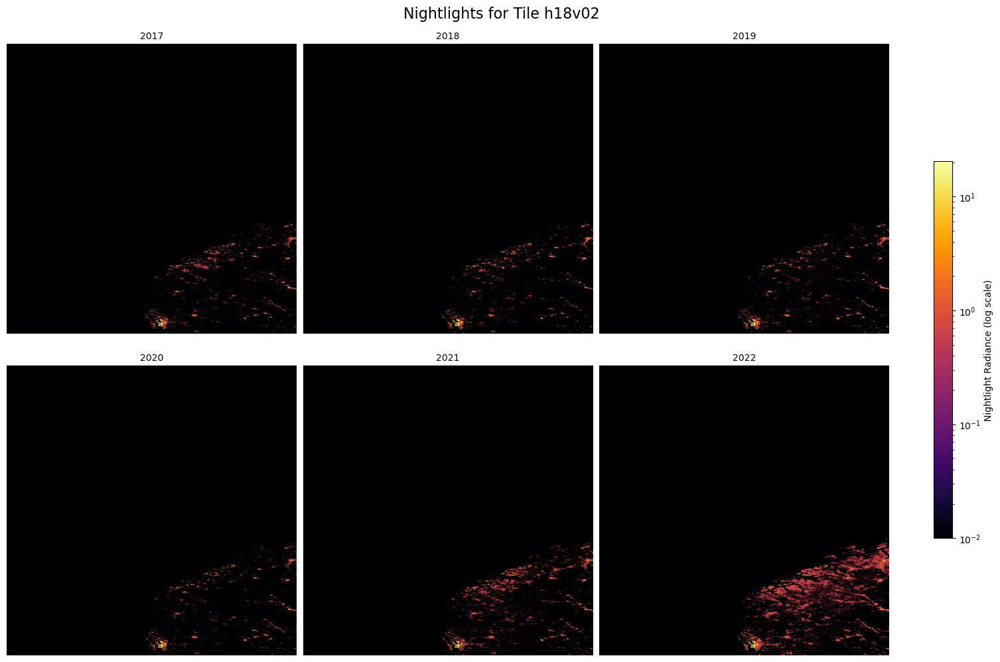

In [101]:
all_ntl_values_masked = []
all_valid_pixels = []

# Loop through files
for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        # Load datasets
        ds_ntl = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ds_num = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Num"]
        ds_lw = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/Land_Water_Mask"]

        ntl = ds_ntl[:].astype(float)
        num = ds_num[:].astype(float)
        lw = ds_lw[:]

        # Apply scale, offset, and fill
        scale = ds_ntl.attrs.get('scale_factor', 1)
        offset = ds_ntl.attrs.get('add_offset', 0)
        fill = ds_ntl.attrs.get('_FillValue')

        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan

        # Mask low observations and water
        ntl[num < 5] = np.nan
        ntl[lw != 1] = np.nan  # land = 1

        # Remove zeros/negatives
        ntl[ntl <= 0] = np.nan

        # Prepare masked version for log scale plotting
        ntl_masked = ntl.copy()
        ntl_masked[np.isnan(ntl_masked)] = 0.01  # avoid zeros
        ntl_masked[ntl_masked < 0.01] = 0.01

        # Save
        all_ntl_values_masked.append(ntl_masked)
        all_valid_pixels.append(ntl.flatten())

# Compute global log scale limits
all_concat = np.concatenate(all_valid_pixels)
all_concat = all_concat[~np.isnan(all_concat)]
vmin = 0.01
vmax = np.nanpercentile(all_concat, 99)
norm = LogNorm(vmin=vmin, vmax=vmax)

# Plot
rows, cols = 2, int(np.ceil(len(h5_files)/2))  # adjust rows/cols as needed
fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

for i, ntl in enumerate(all_ntl_values_masked):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty axes
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
valid_axes = [ax for ax in axes if ax in fig.axes]
cbar = fig.colorbar(im, ax=valid_axes, shrink=0.6)
cbar.set_label("Nightlight Radiance (log scale)")

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h19v02 !!!!

Tile h19v02 bounds:
Longitude: 25.05 → 35.84
Latitude: 57.62 → 68.42



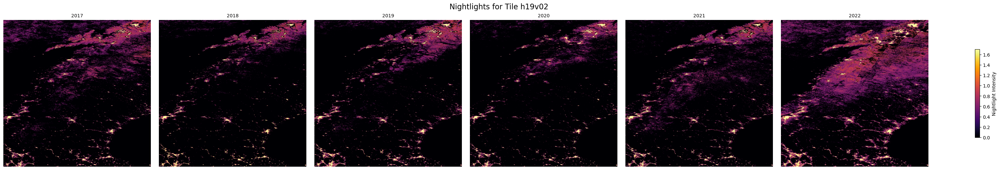

In [85]:
tiles = ["h19v02"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h19v02"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

##### weid purple light (not working properly tho)

In [88]:
with h5py.File(file_path, 'r') as f:
  ds_num = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Num"]
  num = ds_num[:].astype(float)

In [89]:
print("Min observations:", np.nanmin(num))
print("Max observations:", np.nanmax(num))
print("Mean observations:", np.nanmean(num))

Min observations: 0.0
Max observations: 119.0
Mean observations: 40.673307118055554


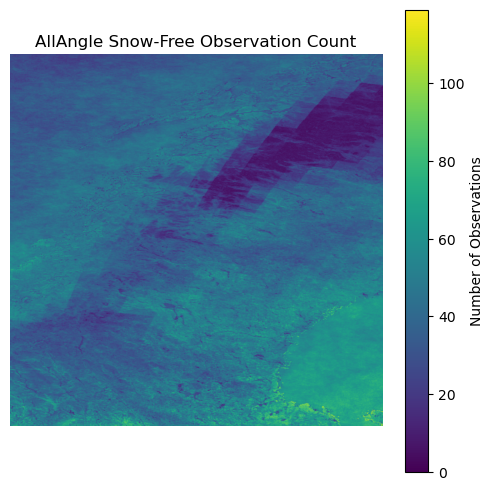

In [91]:
plt.figure(figsize=(6,6))
plt.imshow(num, cmap='viridis')
plt.colorbar(label='Number of Observations')
plt.title("AllAngle Snow-Free Observation Count")
plt.axis('off')
plt.show()

In [93]:
ntl[num < 3] = np.nan

# Mask low observations
ntl[num < 3] = np.nan

# Remove negative values
ntl[ntl <= 0] = np.nan

# Use log scaling
from matplotlib.colors import LogNorm
norm = LogNorm(vmin=1, vmax=np.nanpercentile(ntl, 99))

In [ ]:
all_ntl_values = []
all_valid_pixels = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)

    with h5py.File(file_path, 'r') as f:
        ds_ntl = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ds_num = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Num"]

        ntl = ds_ntl[:].astype(float)
        num = ds_num[:].astype(float)

        scale = ds_ntl.attrs.get('scale_factor', 1)
        offset = ds_ntl.attrs.get('add_offset', 0)
        fill = ds_ntl.attrs.get('_FillValue')

        ntl = ntl * scale + offset

        if fill is not None:
            ntl[ntl == fill] = np.nan

        # 🔹 Mask low observations
        ntl[num < 3] = np.nan

        # 🔹 Remove zero/negative for log scale
        ntl[ntl <= 0] = np.nan

        all_ntl_values.append(ntl)
        all_valid_pixels.append(ntl.flatten())

# 🔹 Compute global log scale limits
all_concat = np.concatenate(all_valid_pixels)
vmin = 1
vmax = np.nanpercentile(all_concat, 99)

norm = LogNorm(vmin=vmin, vmax=vmax)

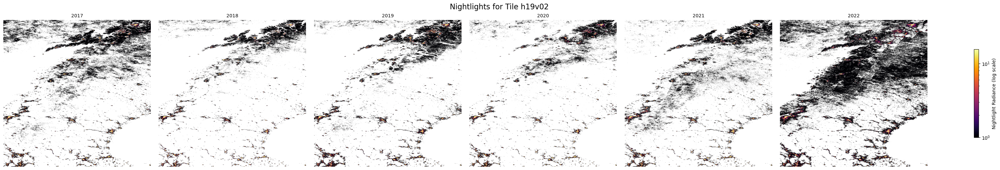

In [95]:
fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])

    im = axes[i].imshow(
        ntl,
        cmap='inferno',
        origin='upper',
        norm=norm
    )

    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty axes
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6)
cbar.set_label("Nightlight Radiance (log scale)")

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h19v03

Tile h19v03 bounds:
Longitude: 25.05 → 35.84
Latitude: 46.83 → 57.62



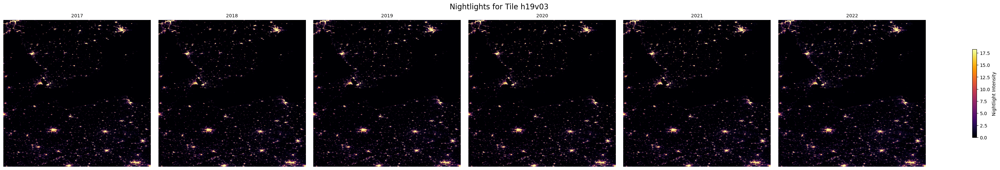

In [71]:
tiles = ["h19v03"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h19v03"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h19v04

Tile h19v04 bounds:
Longitude: 25.05 → 35.84
Latitude: 36.04 → 46.83



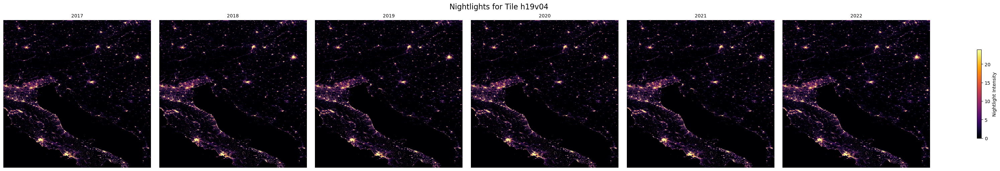

In [72]:
tiles = ["h19v04"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h19v04"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h19v05

Tile h19v05 bounds:
Longitude: 25.05 → 35.84
Latitude: 25.25 → 36.04



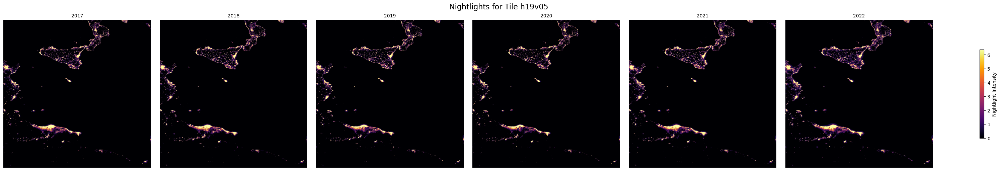

In [73]:
tiles = ["h19v05"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h19v05"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h20v01 !!!!!

Tile h20v01 bounds:
Longitude: 35.84 → 46.63
Latitude: 68.42 → 79.21



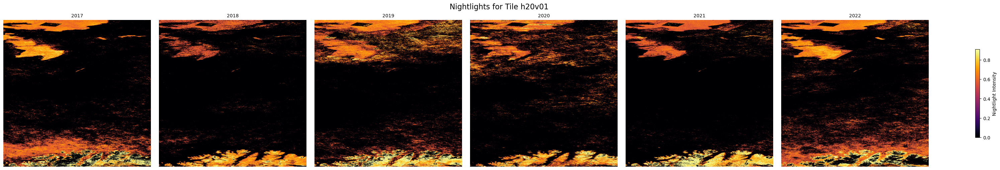

In [102]:
tiles = ["h20v01"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h20v01"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

##### fix orage lights

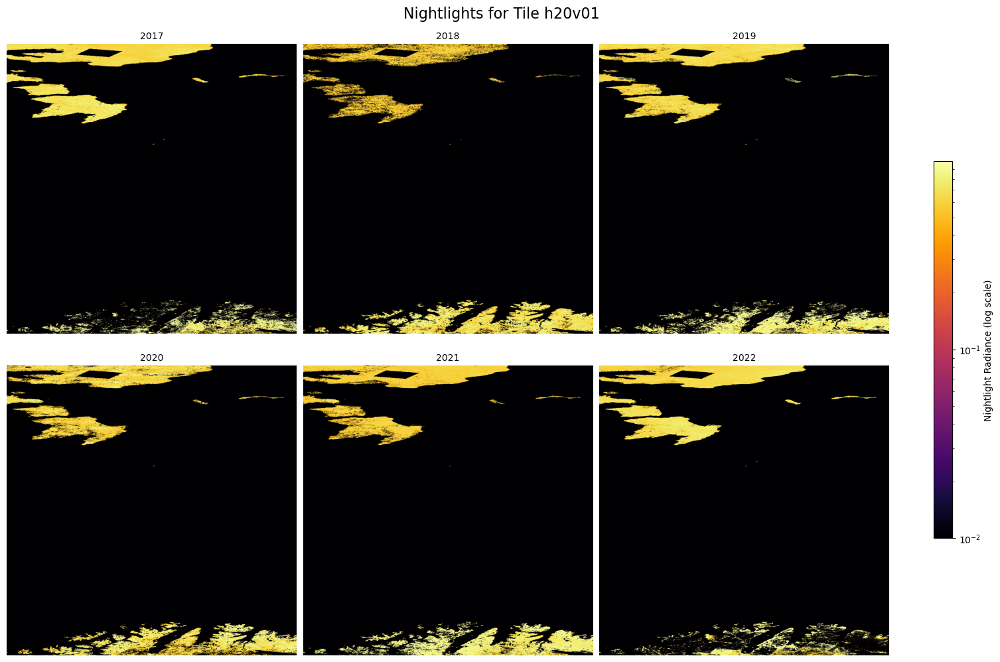

In [103]:
all_ntl_values_masked = []
all_valid_pixels = []

# Loop through files
for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        # Load datasets
        ds_ntl = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ds_num = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Num"]
        ds_lw = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/Land_Water_Mask"]

        ntl = ds_ntl[:].astype(float)
        num = ds_num[:].astype(float)
        lw = ds_lw[:]

        # Apply scale, offset, and fill
        scale = ds_ntl.attrs.get('scale_factor', 1)
        offset = ds_ntl.attrs.get('add_offset', 0)
        fill = ds_ntl.attrs.get('_FillValue')

        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan

        # Mask low observations and water
        ntl[num < 5] = np.nan
        ntl[lw != 1] = np.nan  # land = 1

        # Remove zeros/negatives
        ntl[ntl <= 0] = np.nan

        # Prepare masked version for log scale plotting
        ntl_masked = ntl.copy()
        ntl_masked[np.isnan(ntl_masked)] = 0.01  # avoid zeros
        ntl_masked[ntl_masked < 0.01] = 0.01

        # Save
        all_ntl_values_masked.append(ntl_masked)
        all_valid_pixels.append(ntl.flatten())

# Compute global log scale limits
all_concat = np.concatenate(all_valid_pixels)
all_concat = all_concat[~np.isnan(all_concat)]
vmin = 0.01
vmax = np.nanpercentile(all_concat, 99)
norm = LogNorm(vmin=vmin, vmax=vmax)

# Plot
rows, cols = 2, int(np.ceil(len(h5_files)/2))  # adjust rows/cols as needed
fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

for i, ntl in enumerate(all_ntl_values_masked):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty axes
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
valid_axes = [ax for ax in axes if ax in fig.axes]
cbar = fig.colorbar(im, ax=valid_axes, shrink=0.6)
cbar.set_label("Nightlight Radiance (log scale)")

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h20v02 !!!!!

Tile h20v02 bounds:
Longitude: 35.84 → 46.63
Latitude: 57.62 → 68.42



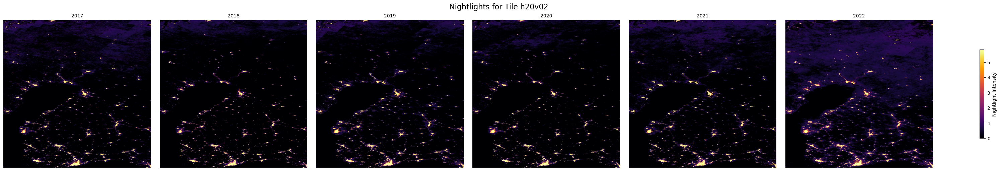

In [75]:
tiles = ["h20v02"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h20v02"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h20v03

Tile h20v03 bounds:
Longitude: 35.84 → 46.63
Latitude: 46.83 → 57.62



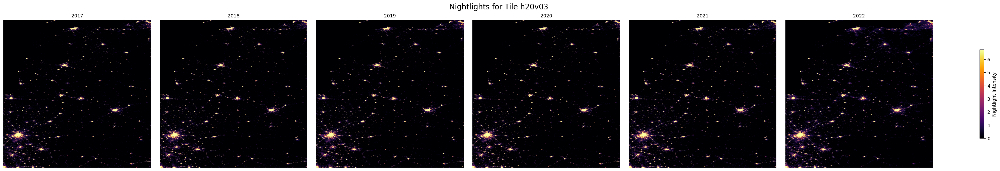

In [76]:
tiles = ["h20v03"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h20v03"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### Expansion difference h20v03

In [116]:
folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h20v03"

def load_year(year):
    # Find file for that year
    file = [f for f in os.listdir(folder_path_h5)
            if f.endswith(".h5") and tile_code in f and f"A{year}" in f][0]
    
    file_path = os.path.join(folder_path_h5, file)
    
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
    
    return ntl

# Load both years
ntl_2017 = load_year(2017)
ntl_2022 = load_year(2022)

# Compute difference
diff = ntl_2022 - ntl_2017

In [117]:
print("Min diff:", np.nanmin(diff))
print("Max diff:", np.nanmax(diff))
print("Mean diff:", np.nanmean(diff))

Min diff: -3809.8726806640625
Max diff: 2365.939112186432
Mean diff: 0.07945882614178376


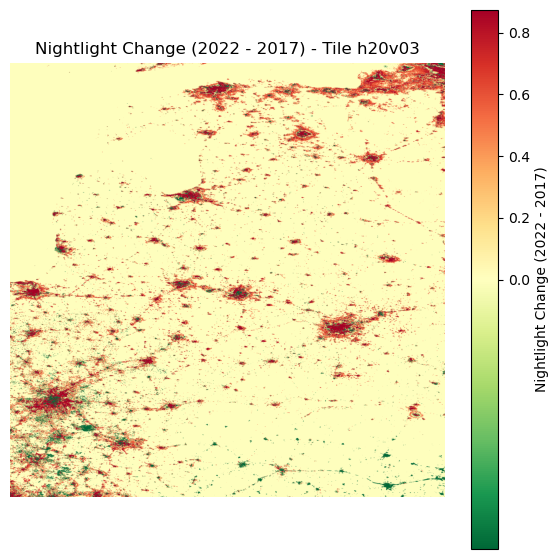

In [118]:
low = np.nanpercentile(diff, 2)
high = np.nanpercentile(diff, 98)

norm = TwoSlopeNorm(vmin=low, vcenter=0, vmax=high)

plt.figure(figsize=(7,7))
plt.imshow(diff, cmap='RdYlGn_r', norm=norm)
plt.colorbar(label='Nightlight Change (2022 - 2017)')
plt.title(f'Nightlight Change (2022 - 2017) - Tile {tile_code}')
plt.axis('off')
plt.show()

#### h20v04

Tile h20v04 bounds:
Longitude: 35.84 → 46.63
Latitude: 36.04 → 46.83



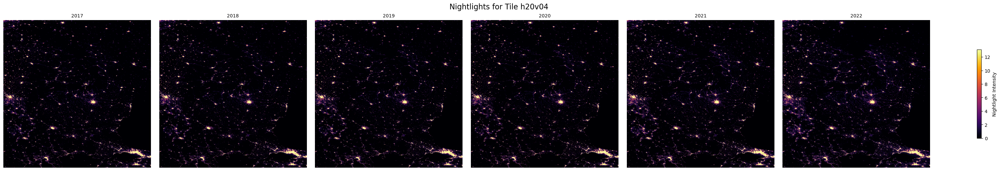

In [77]:
tiles = ["h20v04"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h20v04"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h20v05

Tile h20v05 bounds:
Longitude: 35.84 → 46.63
Latitude: 25.25 → 36.04



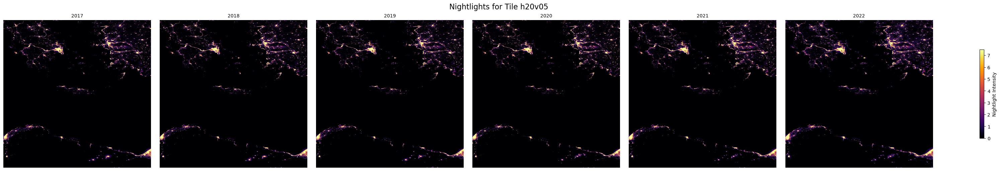

In [78]:
tiles = ["h20v05"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h20v05"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h21v02 !!!!!

Tile h21v02 bounds:
Longitude: 46.63 → 57.42
Latitude: 57.62 → 68.42



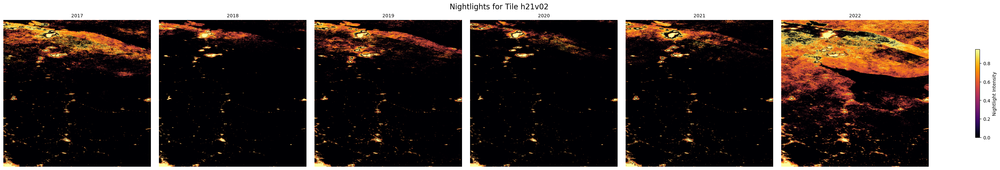

In [104]:
tiles = ["h21v02"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h21v02"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

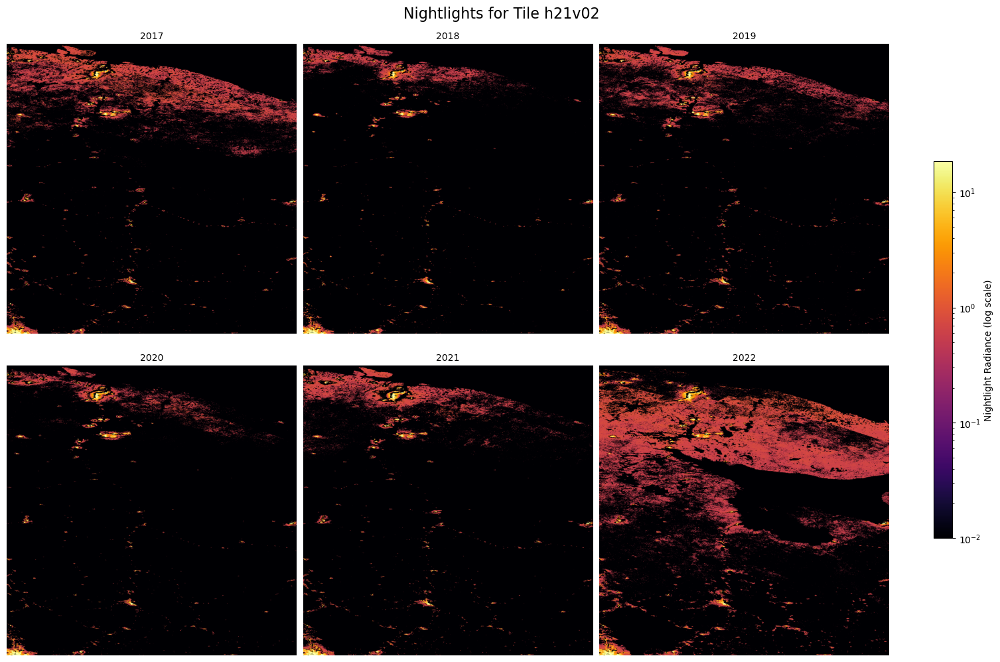

In [105]:
all_ntl_values_masked = []
all_valid_pixels = []

# Loop through files
for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        # Load datasets
        ds_ntl = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ds_num = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free_Num"]
        ds_lw = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/Land_Water_Mask"]

        ntl = ds_ntl[:].astype(float)
        num = ds_num[:].astype(float)
        lw = ds_lw[:]

        # Apply scale, offset, and fill
        scale = ds_ntl.attrs.get('scale_factor', 1)
        offset = ds_ntl.attrs.get('add_offset', 0)
        fill = ds_ntl.attrs.get('_FillValue')

        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan

        # Mask low observations and water
        ntl[num < 5] = np.nan
        ntl[lw != 1] = np.nan  # land = 1

        # Remove zeros/negatives
        ntl[ntl <= 0] = np.nan

        # Prepare masked version for log scale plotting
        ntl_masked = ntl.copy()
        ntl_masked[np.isnan(ntl_masked)] = 0.01  # avoid zeros
        ntl_masked[ntl_masked < 0.01] = 0.01

        # Save
        all_ntl_values_masked.append(ntl_masked)
        all_valid_pixels.append(ntl.flatten())

# Compute global log scale limits
all_concat = np.concatenate(all_valid_pixels)
all_concat = all_concat[~np.isnan(all_concat)]
vmin = 0.01
vmax = np.nanpercentile(all_concat, 99)
norm = LogNorm(vmin=vmin, vmax=vmax)

# Plot
rows, cols = 2, int(np.ceil(len(h5_files)/2))  # adjust rows/cols as needed
fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

for i, ntl in enumerate(all_ntl_values_masked):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty axes
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
valid_axes = [ax for ax in axes if ax in fig.axes]
cbar = fig.colorbar(im, ax=valid_axes, shrink=0.6)
cbar.set_label("Nightlight Radiance (log scale)")

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h21v03

Tile h21v03 bounds:
Longitude: 46.63 → 57.42
Latitude: 46.83 → 57.62



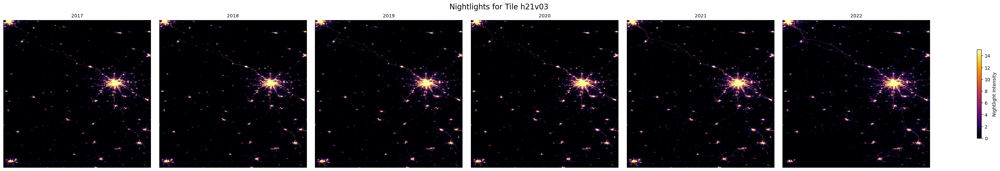

In [81]:
tiles = ["h21v03"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h21v03"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()

#### h21v04

Tile h21v04 bounds:
Longitude: 46.63 → 57.42
Latitude: 36.04 → 46.83



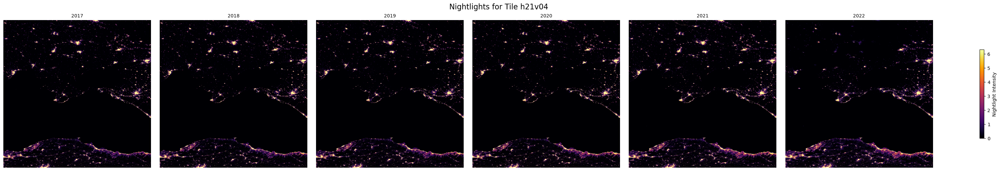

In [82]:
tiles = ["h21v04"]
for tile in tiles:
    lon_min, lon_max, lat_min, lat_max = tile_bounds(tile)
    print(f"Tile {tile} bounds:")
    print(f"Longitude: {lon_min:.2f} → {lon_max:.2f}")
    print(f"Latitude: {lat_min:.2f} → {lat_max:.2f}\n")

folder_path_h5 = "VNP46A4_2-20260213_103212"
tile_code = "h21v04"

h5_files = sorted([f for f in os.listdir(folder_path_h5) 
                   if f.endswith(".h5") and tile_code in f])
n = len(h5_files)

# Automatic grid size
cols = 6
rows = math.ceil(n / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows), constrained_layout=True)
axes = axes.flatten()

# Optional: compute a global vmax for all images for consistent color scale
all_ntl_values = []

for h5_file in h5_files:
    file_path = os.path.join(folder_path_h5, h5_file)
    with h5py.File(file_path, 'r') as f:
        ds = f["HDFEOS/GRIDS/VIIRS_Grid_DNB_2d/Data Fields/AllAngle_Composite_Snow_Free"]
        ntl = ds[:].astype(float)
        scale = ds.attrs.get('scale_factor', 1)
        offset = ds.attrs.get('add_offset', 0)
        fill = ds.attrs.get('_FillValue')
        ntl = ntl * scale + offset
        if fill is not None:
            ntl[ntl == fill] = np.nan
        all_ntl_values.append(ntl)

# Determine global color scale
all_ntl_concat = np.concatenate([arr.flatten() for arr in all_ntl_values])
vmin = np.nanpercentile(all_ntl_concat, 1)   # avoid extreme low outliers
vmax = np.nanpercentile(all_ntl_concat, 99)  # avoid extreme high outliers
norm = Normalize(vmin=vmin, vmax=vmax)

# Plot images
for i, ntl in enumerate(all_ntl_values):
    year = int(h5_files[i].split(".")[1][1:5])
    im = axes[i].imshow(ntl, cmap='inferno', origin='upper', norm=norm)
    axes[i].set_title(f'{year}', fontsize=10)
    axes[i].axis('off')

# Remove empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.tolist(), shrink=0.6, label='Nightlight Intensity')

plt.suptitle(f'Nightlights for Tile {tile_code}', fontsize=16)
plt.show()